# Computing Metacells - Iterative Process

## 1. Setup

In this vignette we will demonstrate how to compute metacells starting with brand-new data, with minimal or no reliance on previous analysis of similar data. This is in contrast to the one-pass vignette, where magically all our decisions were correct and we could immediately compute the final result (in practice, we simply applied there the final results from the iterative process below).

In the real world, the actual process used will fall between these two extremes. That is, by using prior knowledge that applies to the specific data set, some of the decisions we make below will be correct from the start, but most likely, some still need to be revised, andn require some iterations to finalize.

To remove doubt, the results presented here are **not** suitable for use in any serious analysis. This is an example of the process, nothing more.

We'll start with importing the python libraries we'll be using and setup some global configuration. Just importing takes a few seconds, mainly because Python's importing of C++ extensions with a large number of functions is inefficient.

In [1]:
%%time
import anndata as ad             # For reading/writing AnnData files
import matplotlib.pyplot as plt  # For plotting
import metacells as mc           # The Metacells package
import numpy as np               # For array/matrix operations
import pandas as pd              # For data frames
import os                        # For filesystem operations
import seaborn as sb             # For plotting
import scipy.sparse as sp        # For sparse matrices
import shutil                    # for filesystem operations
from math import hypot           # For plotting
from typing import *             # For type annotations

CPU times: user 6.59 s, sys: 9.98 s, total: 16.6 s
Wall time: 5.82 s


Then, configure the packages we use. Feel free to tweak as necessary.

In [2]:
%%time

# Use SVG for scalable low-element-count diagrams.
%config InlineBackend.figure_formats = ["svg"]

# A matter of personal preference.
sb.set_style("white")

# Running operations on an inefficient layout can make code **much** slower.
# For example, summing the columns of a row-major matrix.
# By default this will just be a warning.
# We set it to be an error here to make sure the vignette does not lead you astray.
#
# Note that this only affects the Metacells package.
# Numpy will happily and silently take 100x longer for running such inefficient operations.
# At least, there's no way I can tell to create a warning or error for this;
# also, the implementation for "inefficient" operations could be *much* faster.
#
# The workaround in either case is to explicitly re-layout the 2D matrix before the operations.
# This turns out to be much faster, especially when the matrix can be reused.
# Note that numpy is also very slow when doing matrix re-layout,
# so the metacells package provides a function for doing it more efficiently.
#
# Sigh.
mc.ut.allow_inefficient_layout(False)

CPU times: user 6.09 ms, sys: 0 ns, total: 6.09 ms
Wall time: 5.99 ms


True

Since the process here is iterative, we'll use a separate directory to hold the results of each iteration, to keep things organized. In this example, we'll have 4 iterations in all, as well as the final results.

In [3]:
%%time
shutil.rmtree("../output/iterative", ignore_errors=True)
shutil.rmtree("../mcview/iterative", ignore_errors=True)
os.makedirs("../output/iterative/iteration-1/figures", exist_ok=True)
os.makedirs("../output/iterative/iteration-2", exist_ok=True)
os.makedirs("../output/iterative/iteration-3", exist_ok=True)
os.makedirs("../output/iterative/iteration-4", exist_ok=True)
os.makedirs("../output/iterative/final", exist_ok=True)

CPU times: user 3.58 ms, sys: 2.93 s, total: 2.93 s
Wall time: 11.3 s


## 2. Reading the data

Our input here is the "full" data. This data already isn't the "raw" data. That is, we expect it to have gone through preliminary processing using basic cell-oriented tools. For example, removing "doublet" cells, cells which are actually empty wells, etc. The specifics of such pre-processing may be different for each data set, and are outside the scope of this vignette.

Reading this data  takes a ridiculously long time necause the AnnData implementation, in its infinite wisdom, does not use memory-mapping. When we switch to using `DAF` things would be much better and faster.

In [4]:
%%time
full = ad.read_h5ad("../blobs/hca_bm.full.h5ad")
mc.ut.top_level(full)
mc.ut.set_name(full, "hca_bm.full")
print(f"Full: {full.n_obs} cells, {full.n_vars} genes")

Full: 378000 cells, 33694 genes
CPU times: user 382 ms, sys: 27.4 s, total: 27.8 s
Wall time: 48.7 s


## 3. Cleaning the data

Having this "full" data, we will demonstrate performing some additional "universal" steps to extract the "clean" data out of it. Importantly, all we will do here is select which subset of the data to use; we will not perform any corrections (such as batch corrections) here. Such corrections are better applies based on the resulting metacell model, as this will allow cell-type-specific analysis to be done.

### 3.1 Decisions

Cleaning up the data (whether in pre-processing or using the steps below) requires us to make decisions, based on prior biological knowledge and experience with the pipeline. Also, none of the decisions is final. As demonstrated here, we typically iterate the analysis, revisiting and refining prior decisions, until we obtain a "good" final result. This is in contrast to the one-pass vignette where we assume all decisions are "correct" from the start.

#### 3.1.1 Excluding cells by UMIs count

The first decision we need to make is "how many UMIs does a clean cell contain".
Cells with "too few" UMIs indicate very low-quality sampling and might be just empty droplets.
Cells with "too many" UMIs might be doublets.
The thresholds to use depend on the technology and the dataset, and the specifics of any pre-processing done, if any. The method we use here is to look at the distribution of total UMIs per cell,
and pick "reasonable" thresholds for exclusions based on it.

This operation is identical to the matching one in the one-pass vignette.

In [5]:
PROPERLY_SAMPLED_MIN_CELL_TOTAL = 800
PROPERLY_SAMPLED_MAX_CELL_TOTAL = 20000

We can visualize the cell UMIs threshold decision and adjust it accordingly:

Will exclude 66232 (17.52%%) cells with less than 800 UMIs
Will exclude 8672 (25.74%%) cells with more than 20000 UMIs
CPU times: user 5.2 s, sys: 575 ms, total: 5.77 s
Wall time: 5.14 s


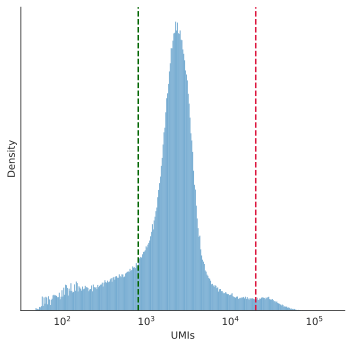

In [6]:
%%time
total_umis_per_cell = mc.ut.get_o_numpy(full, "__x__", sum=True)
plot = sb.displot(total_umis_per_cell, log_scale=(10, None))
plot.set(xlabel="UMIs", ylabel="Density", yticks=[])

plot.refline(x=PROPERLY_SAMPLED_MIN_CELL_TOTAL, color="darkgreen")
plot.refline(x=PROPERLY_SAMPLED_MAX_CELL_TOTAL, color="crimson")

plt.savefig("../output/iterative/iteration-1/figures/cell_total_umis.svg")

too_small_cells_count = np.sum(total_umis_per_cell < PROPERLY_SAMPLED_MIN_CELL_TOTAL)
too_large_cells_count = np.sum(total_umis_per_cell > PROPERLY_SAMPLED_MAX_CELL_TOTAL)

total_umis_per_cell = mc.ut.get_o_numpy(full, name="__x__", sum=True)
too_small_cells_percent = 100.0 * too_small_cells_count / full.n_obs
too_large_cells_percent = 100.0 * too_large_cells_count / full.n_vars

print(
    f"Will exclude {too_small_cells_count} ({too_small_cells_percent:.2f}%%) cells"
    f" with less than {PROPERLY_SAMPLED_MIN_CELL_TOTAL} UMIs"
)
print(
    f"Will exclude {too_large_cells_count} ({too_large_cells_percent:.2f}%%) cells"
    f" with more than {PROPERLY_SAMPLED_MAX_CELL_TOTAL} UMIs"
)

#### 3.1.2 Excluding genes by name

The next decision we need to make is which genes to exclude from the data, by their names.
The poster children for this are mytochondrial genes and strong sex-chromosome genes.

Later on in the analysis we will revisit this, and exclude additional genes. This is in contrast to the one-pass vignette where we get right the list from the start. Realistically, one would start with a list that was used for similar data in the past, and possibly tweak it later as needed.

In [7]:
EXCLUDED_GENE_NAMES = ["XIST", "MALAT1"]  # Sex-specific genes.
EXCLUDED_GENE_PATTERNS = ["MT-.*"]        # Mitochondrial.

We'll instruct the package to exclude the genes we have chosen.
By default, the code will also automatically exclude a few additional genes,
specifically genes with very high variance that are not correlated with any other gene (`bursty_lonely_gene`, see the documentation for details).
Such genes are useless for grouping cells together;
even worse, including them is actively harmful as they cause cells to appear to be deviants
(have a gene in which they are very different from the rest of the cells in the same metacell),
and thereby be marked as outliers.

In [8]:
%%time
mc.pl.exclude_genes(
    full,
    excluded_gene_names=EXCLUDED_GENE_NAMES, 
    excluded_gene_patterns=EXCLUDED_GENE_PATTERNS,
    random_seed=123456,
)

set hca_bm.full.var[bursty_lonely_gene]: 0 true (0%) out of 33694 bools
set hca_bm.full.var[properly_sampled_gene]: 27277 true (80.96%) out of 33694 bools
set hca_bm.full.var[excluded_gene]: 6432 true (19.09%) out of 33694 bools


CPU times: user 38.6 s, sys: 19.5 s, total: 58.1 s
Wall time: 43.5 s


#### 3.1.3 Excluding cells by high excluded gene UMIs

The next decision we need to make is which cells to exclude due to
containing too many UMIs in the excluded genes.
If a cell contains "too many" excluded (mainly mytochondrial) gene UMIs,
this may indicate a badly sampled cell, leading to very skewed results.
Again, the exact threshold depends on both the technology and the dataset.
Here we resort to looking at the distribution of the fraction of excluded genes in each cell,
and manually picking the threshold.

We start by computing the total UMIs of excluded genes in each cell.
We only need to do this once (as long as we don't change the list of excluded genes).

In [9]:
%%time
mc.tl.compute_excluded_gene_umis(full)

set hca_bm.full.obs[excluded_umis]: 378000 float32s


CPU times: user 5.02 s, sys: 7.27 s, total: 12.3 s
Wall time: 12.3 s


Next we'll pick a maximal fraction of excluded UMIs in each cell.

In [10]:
PROPERLY_SAMPLED_MAX_EXCLUDED_GENES_FRACTION = 0.25

We can visualize the cell excluded genes fraction threshold decision and adjust it accordingly:

Will exclude 36306 (9.60%) cells with more than 25.00% excluded gene UMIs
CPU times: user 1.28 s, sys: 616 ms, total: 1.9 s
Wall time: 1.45 s


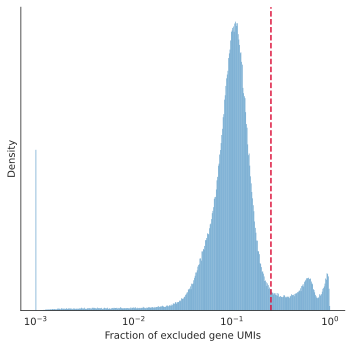

In [11]:
%%time
excluded_umis_fraction_regularization = 1e-3  # Avoid 0 values in log scale plot.
excluded_umis_per_cell = mc.ut.get_o_numpy(full, "excluded_umis")
excluded_umis_fraction_per_cell = excluded_umis_per_cell / total_umis_per_cell

excluded_umis_fraction_per_cell += excluded_umis_fraction_regularization
plot = sb.displot(excluded_umis_fraction_per_cell, log_scale=(10, None))
excluded_umis_fraction_per_cell -= excluded_umis_fraction_regularization

plot.set(xlabel="Fraction of excluded gene UMIs", ylabel="Density", yticks=[])
plot.refline(x=PROPERLY_SAMPLED_MAX_EXCLUDED_GENES_FRACTION, color="crimson")

plt.savefig("../output/iterative/iteration-1/figures/cell_excluded_umis_fraction.svg")

too_excluded_cells_count = np.sum(
    excluded_umis_fraction_per_cell > PROPERLY_SAMPLED_MAX_EXCLUDED_GENES_FRACTION
)
too_excluded_cells_fraction = too_excluded_cells_count / len(total_umis_per_cell)

print(
    f"Will exclude {too_excluded_cells_count} ({100 * too_excluded_cells_fraction:.2f}%) cells"
    f" with more than {100 * PROPERLY_SAMPLED_MAX_EXCLUDED_GENES_FRACTION:.2f}% excluded gene UMIs"
)

We can now instruct the package to exclude the cells we have chosen.

In [12]:
%%time
mc.pl.exclude_cells(
    full,
    properly_sampled_min_cell_total=PROPERLY_SAMPLED_MIN_CELL_TOTAL,
    properly_sampled_max_cell_total=PROPERLY_SAMPLED_MAX_CELL_TOTAL,
    properly_sampled_max_excluded_genes_fraction=PROPERLY_SAMPLED_MAX_EXCLUDED_GENES_FRACTION,
)

set hca_bm.full.obs[properly_sampled_cell]: 297890 true (78.81%) out of 378000 bools
set hca_bm.full.obs[excluded_cell]: 80110 true (21.19%) out of 378000 bools


CPU times: user 4.23 ms, sys: 267 µs, total: 4.5 ms
Wall time: 3.58 ms


### 3.2 Extract the clean data

Having decided on which cells and genes to exclude, we can now extract the clean data out of the full dataset.

In [13]:
%%time
clean = mc.pl.extract_clean_data(full, name="hca_bm.iteration-1.clean")
mc.ut.top_level(clean)
print(f"Clean: {clean.n_obs} cells, {clean.n_vars} genes")

set hca_bm.iteration-1.clean.obs[full_cell_index]: 297890 int32s
set hca_bm.iteration-1.clean.var[full_gene_index]: 27262 int32s


Clean: 297890 cells, 27262 genes
CPU times: user 26.7 s, sys: 22.1 s, total: 48.8 s
Wall time: 48.8 s


### 3.3 Save the data

It is good practice keep the pristine input data in case we'll need to do something else with it. We'll therefore save a copy of the "full" data with the manual annotations we have collected, as well as the "clean" data we extracted from it. We do this prior to computing metacells, which will add further annotations, so we'll be able to easily go back to the unannotated versions of the data if (realistically, when) we revise our decisions.

Using AnnData, this is a full copy of the data; when we'll switch to DAF we'll be able to just store the additional annotations we made, which would take practically no space and be much faster.

In [14]:
%%time
full.write_h5ad("../output/iterative/iteration-1/hca_bm.full.h5ad")
full = None  # Alow it to be gc-ed

CPU times: user 665 ms, sys: 28.6 s, total: 29.3 s
Wall time: 1min 22s


In [15]:
%%time
clean.write_h5ad("../output/iterative/iteration-1/hca_bm.clean.h5ad")

CPU times: user 313 ms, sys: 21.5 s, total: 21.8 s
Wall time: 1min 4s


## 4. Compute the 1st iteration metacells

We'll rename our data to "cells" to distinguish it from the metacells we are about to compute. We'll be adding annotations to this data (most importantly, the metacell each cell belongs to), and will later save it separately from the "clean" data we saved above.

In [16]:
%%time
cells = clean
clean = None  # Allow it to be gc-ed
mc.ut.set_name(cells, "hca_bm.iteration-1.cells")
print(f"Iteration 1: {cells.n_obs} cells, {cells.n_vars} genes")

Iteration 1: 297890 cells, 27262 genes
CPU times: user 33 µs, sys: 54 µs, total: 87 µs
Wall time: 79.6 µs


### 4.1 Decisions

Even though we have the clean cells data, we can't compute metacells for it before making a few more decisions.

#### 4.1.2 Lateral genes

A crucial decision when running metacells is the list of genes are lateral,
that is, should **not** be used to group cells together.
The poster child for this are cell-cycle genes.
These genes are strong and any clustering algorithm will therefore prefer to group together cells in the same cell-cycle state,
at the expense of mixing up (reasonably close) other cell states,
which are what we are actually interested in.
Note that lateral genes are still used in deviant cell detection,
that is, each lateral gene should still have a consistent level in all the cells in each metacell.

Since our data is brand-new, we don't have a good comprehensive list of lateral genes for it, so we'll need to come up with an initial one, with the expectation we'll be adding more genes down the line during the iterative process.

To create this initial list, we'll start with a very short list of "base" lateral genes, using biological prior knowledge. The list below is not universal (it is specific to human cells, for one thing), but it is a start (cell cycle, stress, ribosomal). We'll then expand it with correlated genes.

Realistically, one would start with a list that was used for similar data in the past, skip the correlated genes expannsion, and possibly tweak it later as needed. However we show here the process staring with no similar data at all, so this (admittedly tedious) step is required.

In [17]:
BASE_LATERAL_GENE_NAMES = [
    "AURKA", "MCM3", "MCM4", "MCM7", "MKI67", "PCNA",  # Cell-cycle
    "RRM2", "SMC4", "TOP1A", "TPX2", "UBEC2C",         # Cell-cycle
    "FOS", "H1F1A", "HSP90AB1", "TXN",                 # Stress
]
BASE_LATERAL_GENE_PATTERNS = ["RP[LS].*"]  # Ribosomal

In [18]:
%%time

# We'll reuse this through the iterations.
# It is just a thin wrapper for mark_lateral_genes,
# and optionally also shows the results.
def update_lateral_genes(
    *,
    names: List[str] = [],
    patterns: List[str] = [],
    op: str = "set",
    show: bool = True
) -> None:
    mc.pl.mark_lateral_genes(
        cells,
        lateral_gene_names=names,
        lateral_gene_patterns=patterns,
        op=op
    )

    if not show:
        return
    
    lateral_genes_mask = mc.ut.get_v_numpy(cells, "lateral_gene")
    lateral_gene_names = set(cells.var_names[lateral_genes_mask])
    
    print(sorted([
        name for name in lateral_gene_names
        if not name.startswith("RPL") and not name.startswith("RPS")
    ]))

    print(f"""and {len([
        name for name in lateral_gene_names if name.startswith("RPL") or name.startswith("RPS")
    ])} RP[LS].* genes""")

update_lateral_genes(names=BASE_LATERAL_GENE_NAMES, patterns=BASE_LATERAL_GENE_PATTERNS)

set hca_bm.iteration-1.cells.var[lateral_gene]: 115 true (0.4218%) out of 27262 bools


['AURKA', 'FOS', 'HSP90AB1', 'MCM3', 'MCM4', 'MCM7', 'MKI67', 'PCNA', 'RRM2', 'SMC4', 'TPX2', 'TXN']
and 103 RP[LS].* genes
CPU times: user 18.6 ms, sys: 337 µs, total: 18.9 ms
Wall time: 18.4 ms


Since our initial list was very partial,
we would like to extend it to include any genes highly-correlated with them
(as long as this makes sense, biologically speaking).

Manually looking at all 20-30,000 genes to see whether they are correlated with the base genes is obviously not practical.
We therefore provide a function that tries to reduce the amount of genes we need to look at,
by computing correlations between genes and clustering them to "related gene modules".
We can then examine only such modules that contain base lateral genes (or that are correlated with such modules).

When we do this, we conservatively include any genes that we *might* want to add to the lateral genes list (that is, lean heavily in favor of "false positive" errors). We expect the vast majority of the candidates we look at to *not* be added as lateral genes; what is more important is that we do not miss any gene that we *will* want to add.

In [19]:
%%time
mc.pl.relate_to_lateral_genes(cells, random_seed=123456)

set hca_bm.iteration-1.cells.var[lateral_genes_module]: 24299 outliers (89.13%) and 2963 grouped (10.87%) out of 27262 int32 elements with 76 groups with mean size 38.99
set hca_bm.iteration-1.cells.varp[lateral_genes_similarity]: csr_matrix 27262 X 27262 float32s (8779369 > 0, 1.181%)


CPU times: user 5min 21s, sys: 2.36 s, total: 5min 23s
Wall time: 16.9 s


This correlates all the genes with each other, and clusters them. This is still a lot of data, so let's condense it to the correlation between the overall related gene modules (clusters).

In [20]:
%%time
base_lateral_genes_mask = mc.ut.get_v_numpy(cells, "lateral_gene")
base_lateral_gene_names = set(cells.var_names[base_lateral_genes_mask])

module_per_gene = mc.ut.get_v_series(cells, "lateral_genes_module")
base_lateral_gene_modules = np.unique(module_per_gene.values[base_lateral_genes_mask])
base_lateral_gene_modules = set(base_lateral_gene_modules[base_lateral_gene_modules >= 0])

genes_per_module = np.unique(module_per_gene.values, return_counts=True)[1][1:]
similarity_of_modules = mc.ut.get_vv_proper(cells, "lateral_genes_similarity")
similarity_of_modules = mc.ut.sum_groups(similarity_of_modules, module_per_gene.values, per="row")[0]
similarity_of_modules = mc.ut.to_layout(similarity_of_modules, layout="column_major")
similarity_of_modules = \
    mc.ut.sum_groups(similarity_of_modules, module_per_gene.values, per="column")[0]
similarity_of_modules /= genes_per_module[:, np.newaxis] * genes_per_module[np.newaxis, :]

module_names = [
    f"(*) {gene_module}" if gene_module in base_lateral_gene_modules else str(gene_module)
    for gene_module in range(np.max(module_per_gene.values) + 1)
]
similarity_of_modules = pd.DataFrame(similarity_of_modules, index=module_names, columns=module_names)

CPU times: user 10.1 ms, sys: 1min 57s, total: 1min 57s
Wall time: 2min 4s


We can visualize this to use as a coarse guide when looking into the specific modules:

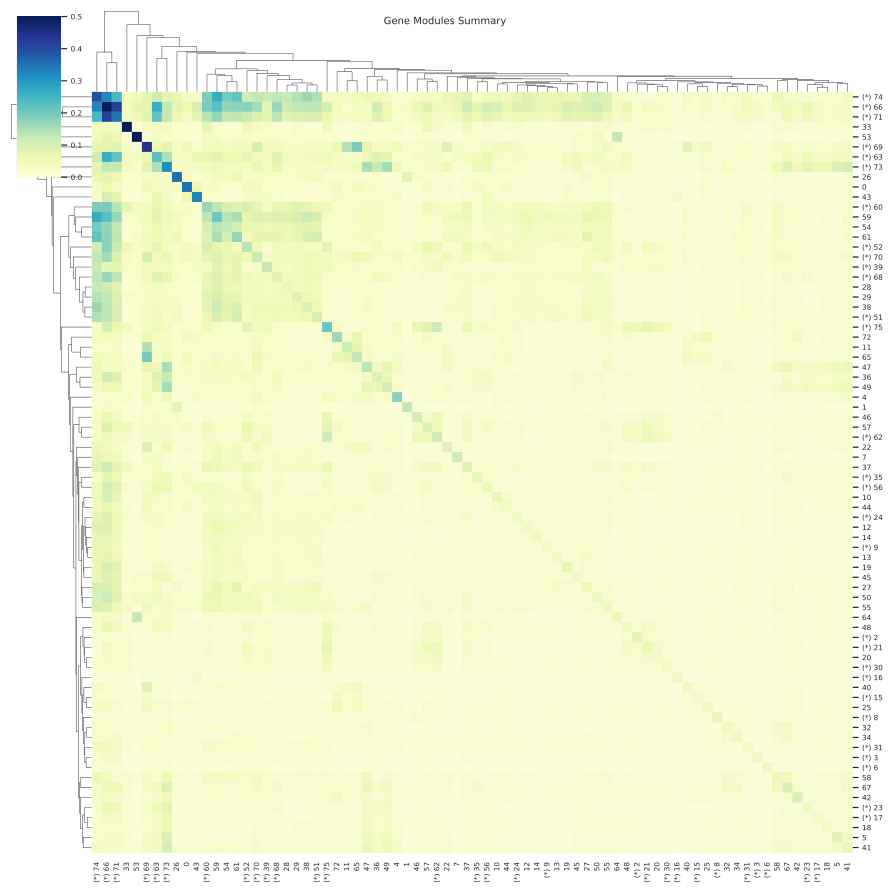

CPU times: user 4.21 s, sys: 13.5 s, total: 17.7 s
Wall time: 12.7 s


In [21]:
%%time
size = similarity_of_modules.shape[0]
if size > 50:
    sb.set(font_scale=50 / size)
size = size * 0.15 + 1
cm = sb.clustermap(
    similarity_of_modules,
    figsize=(size, size),
    vmin=0, vmax=0.5,
    xticklabels=True, yticklabels=True,
    dendrogram_ratio=0.1,
    cmap="YlGnBu",
)
cm.fig.suptitle("Gene Modules Summary", fontsize=10)

plt.savefig("../output/iterative/iteration-1/figures/genes_modules_correlations.svg")

plt.show()
sb.set(font_scale=1.0)

We now visually inspect each of the potentially relevant gene modules, to decide on which additional genes to list as lateral. We'll generate a disk file for the figure of each module for offline inspection, but only show here in the notebook the gene modules that contain lateral genes, or are potentially correlated with other gene module(s) that contain lateral genes. These would still be "quite a few" modules to go through. For each one, we need to decide whether we want to ignore the module, add all its genes as lateral, or possibly add just a few of its genes as lateral. This depends on biological knowledge, and often requires looking at some resources (such as [genecards](https://www.genecards.org/) or even published papers) to make the choice.

<Figure size 136.8x136.8 with 0 Axes>

<Figure size 180x180 with 0 Axes>

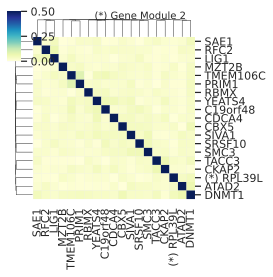

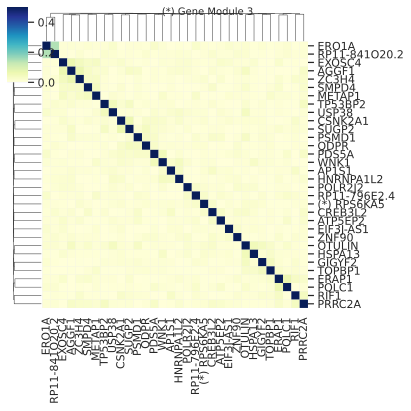

<Figure size 147.6x147.6 with 0 Axes>

<Figure size 277.2x277.2 with 0 Axes>

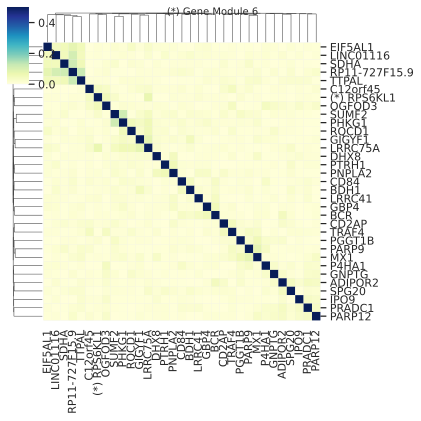

<Figure size 190.8x190.8 with 0 Axes>

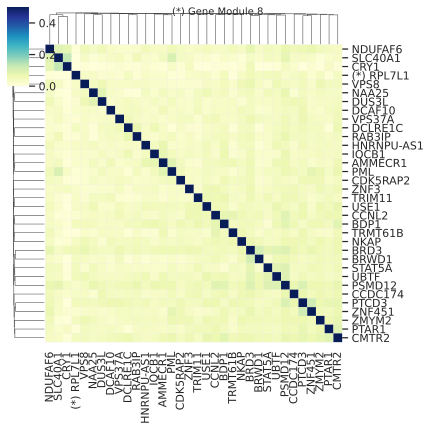

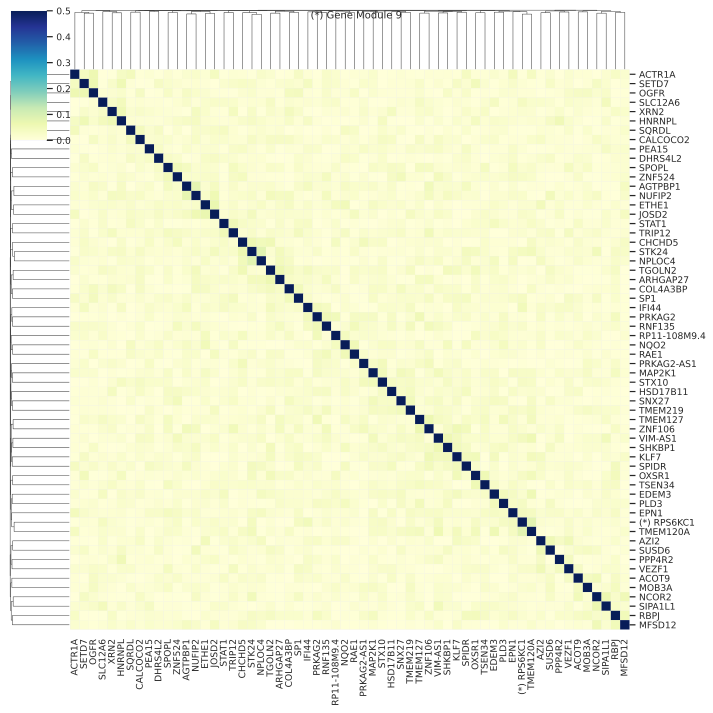

<Figure size 428.4x428.4 with 0 Axes>

<Figure size 266.4x266.4 with 0 Axes>

<Figure size 676.8x676.8 with 0 Axes>

<Figure size 633.6x633.6 with 0 Axes>

<Figure size 471.6x471.6 with 0 Axes>

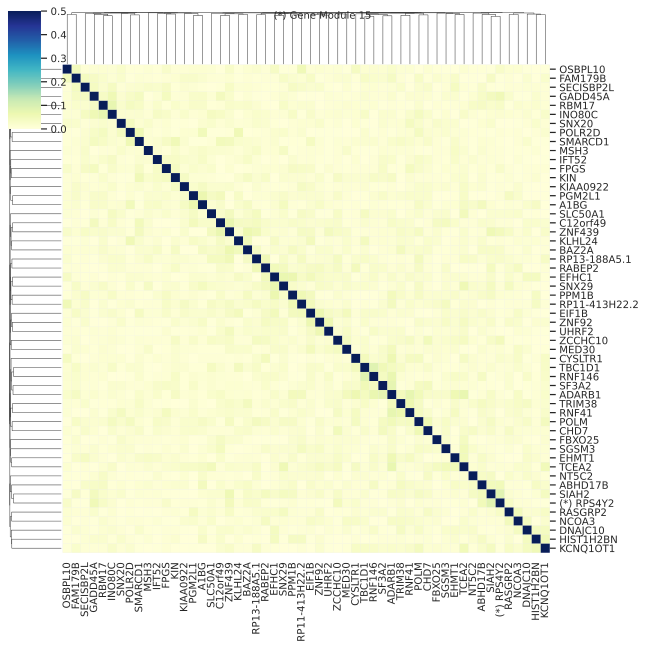

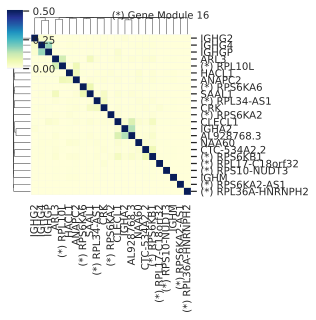

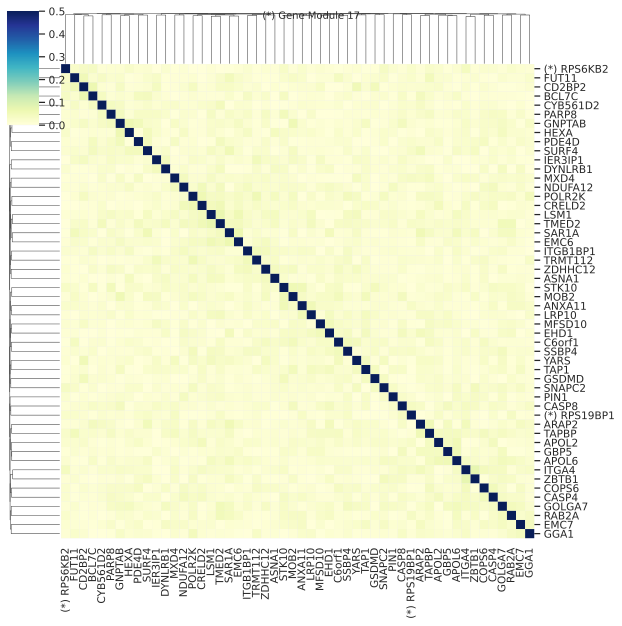

<Figure size 698.4x698.4 with 0 Axes>

<Figure size 298.8x298.8 with 0 Axes>

<Figure size 763.2x763.2 with 0 Axes>

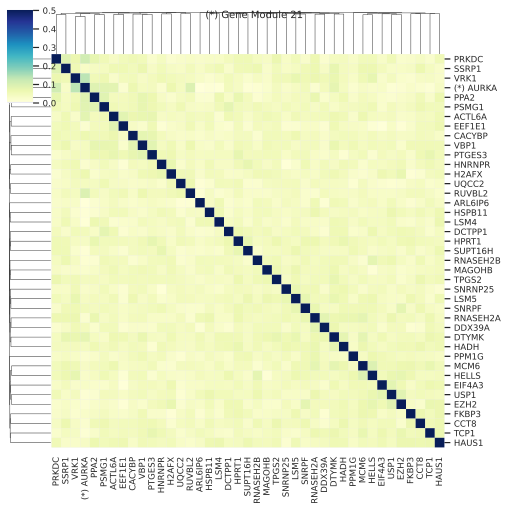

<Figure size 288x288 with 0 Axes>

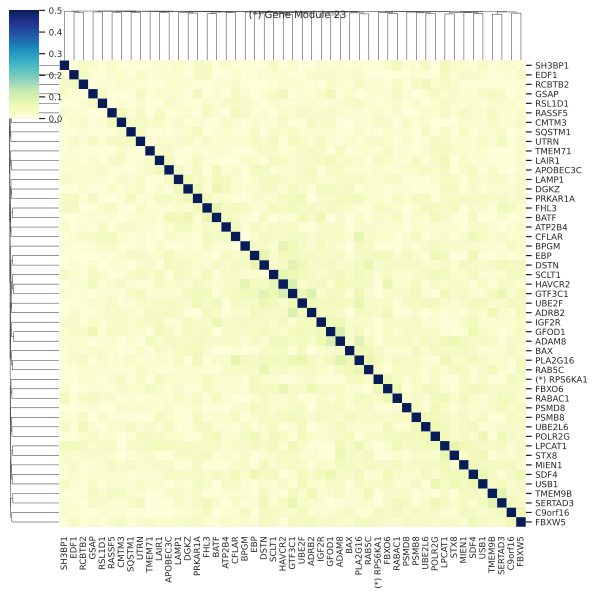

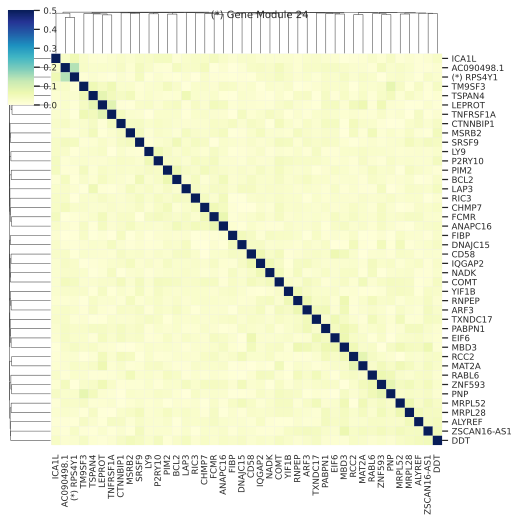

<Figure size 601.2x601.2 with 0 Axes>

<Figure size 147.6x147.6 with 0 Axes>

<Figure size 644.4x644.4 with 0 Axes>

<Figure size 612x612 with 0 Axes>

<Figure size 482.4x482.4 with 0 Axes>

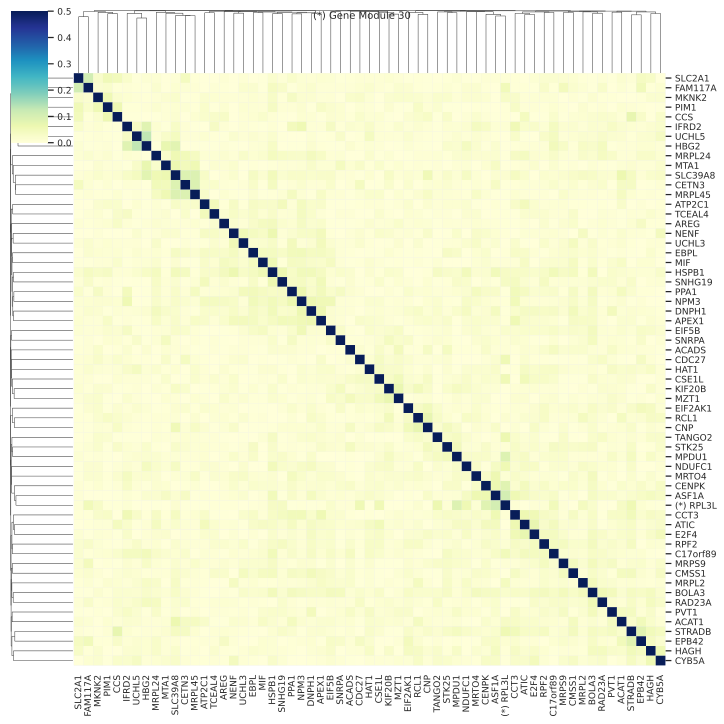

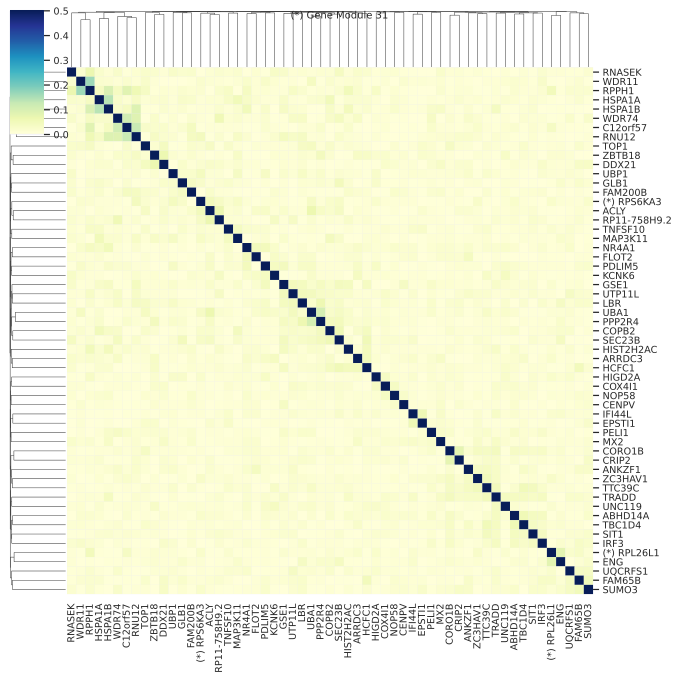

<Figure size 720x720 with 0 Axes>

<Figure size 147.6x147.6 with 0 Axes>

<Figure size 601.2x601.2 with 0 Axes>

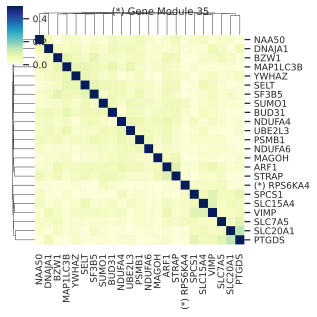

<Figure size 396x396 with 0 Axes>

<Figure size 352.8x352.8 with 0 Axes>

<Figure size 676.8x676.8 with 0 Axes>

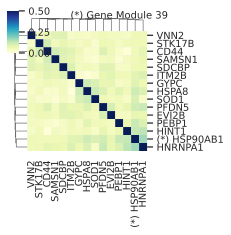

<Figure size 601.2x601.2 with 0 Axes>

<Figure size 482.4x482.4 with 0 Axes>

<Figure size 277.2x277.2 with 0 Axes>

<Figure size 190.8x190.8 with 0 Axes>

<Figure size 709.2x709.2 with 0 Axes>

<Figure size 612x612 with 0 Axes>

<Figure size 255.6x255.6 with 0 Axes>

<Figure size 363.6x363.6 with 0 Axes>

<Figure size 676.8x676.8 with 0 Axes>

<Figure size 579.6x579.6 with 0 Axes>

<Figure size 579.6x579.6 with 0 Axes>

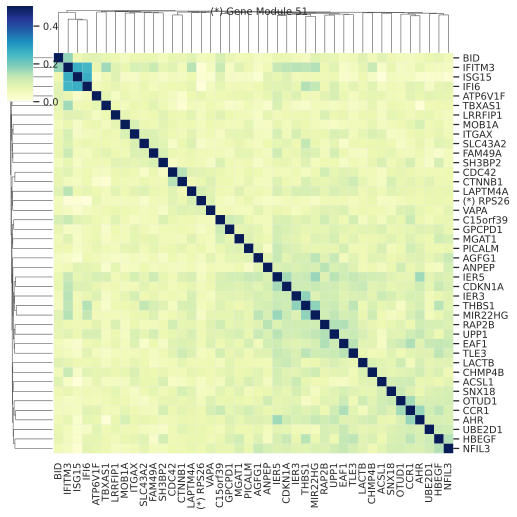

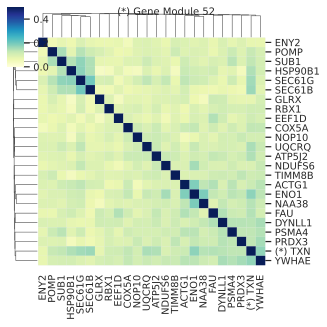

<Figure size 234x234 with 0 Axes>

<Figure size 612x612 with 0 Axes>

<Figure size 730.8x730.8 with 0 Axes>

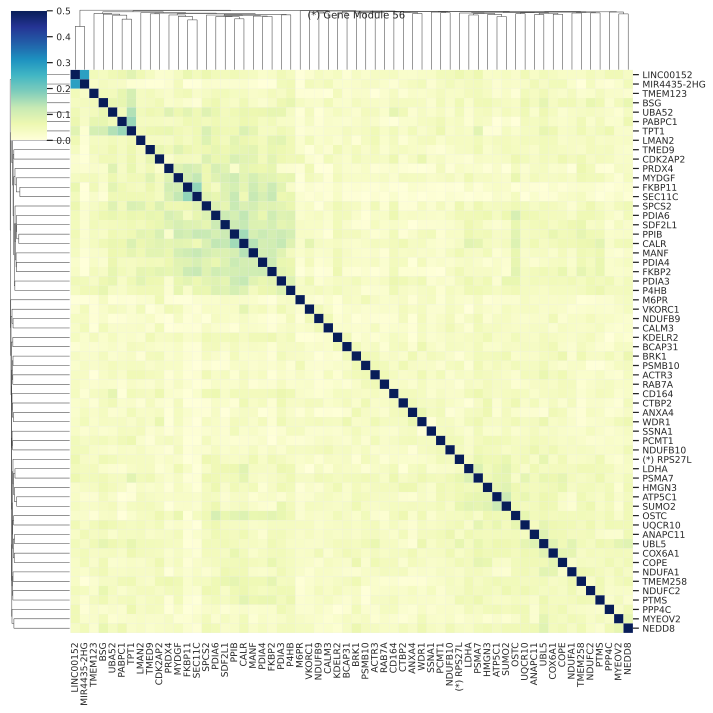

<Figure size 547.2x547.2 with 0 Axes>

<Figure size 741.6x741.6 with 0 Axes>

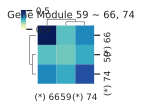

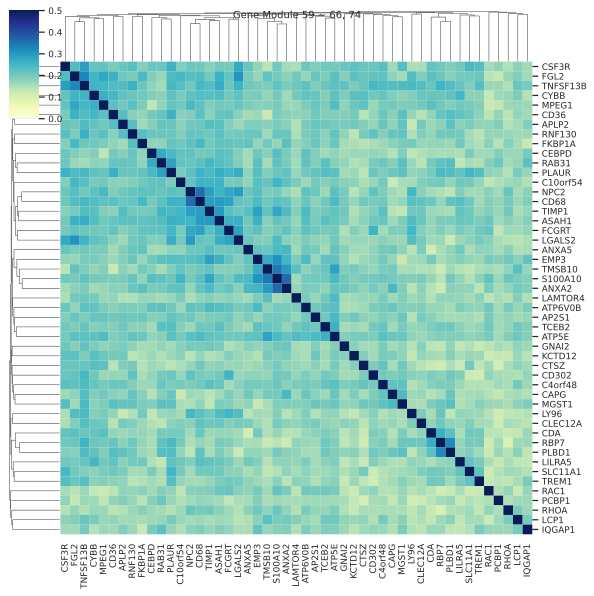

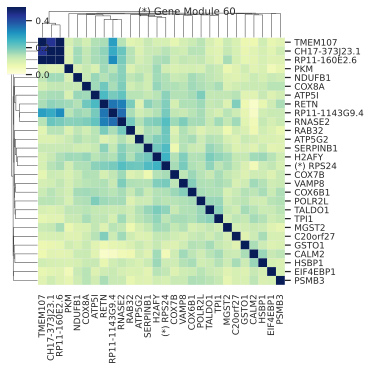

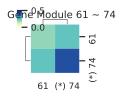

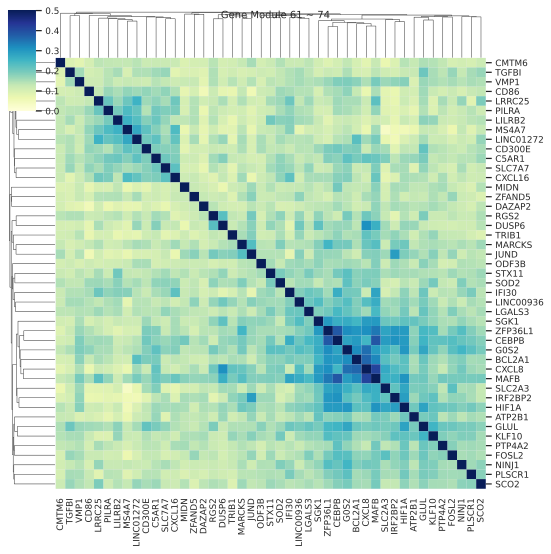

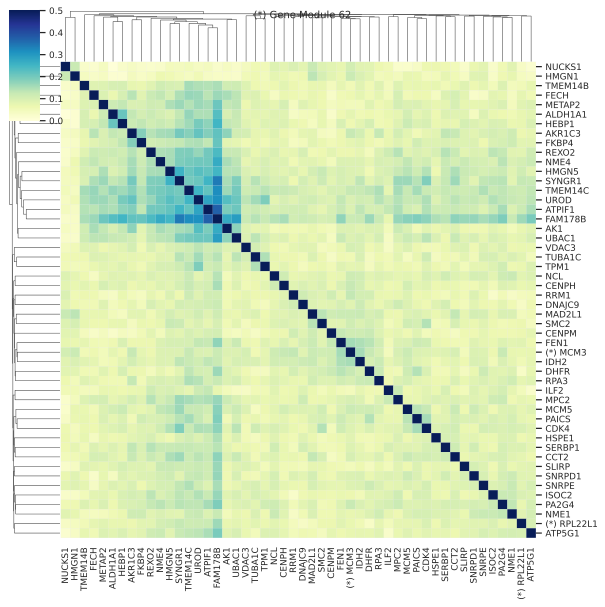

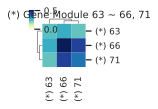

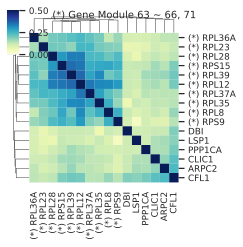

<Figure size 698.4x698.4 with 0 Axes>

<Figure size 687.6x687.6 with 0 Axes>

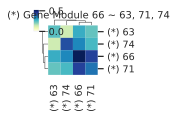

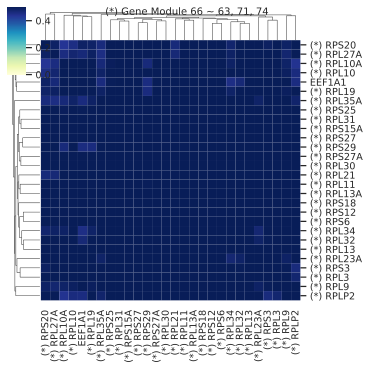

<Figure size 536.4x536.4 with 0 Axes>

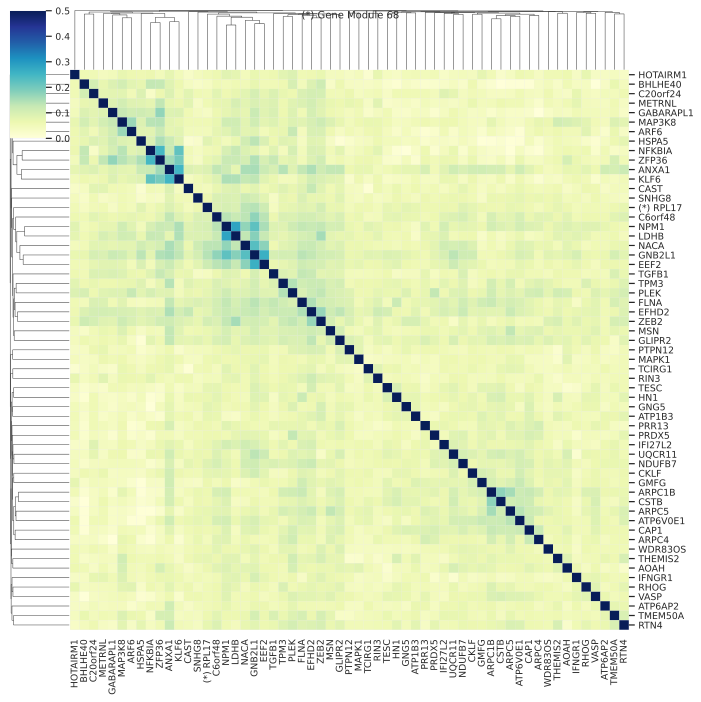

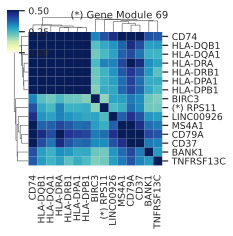

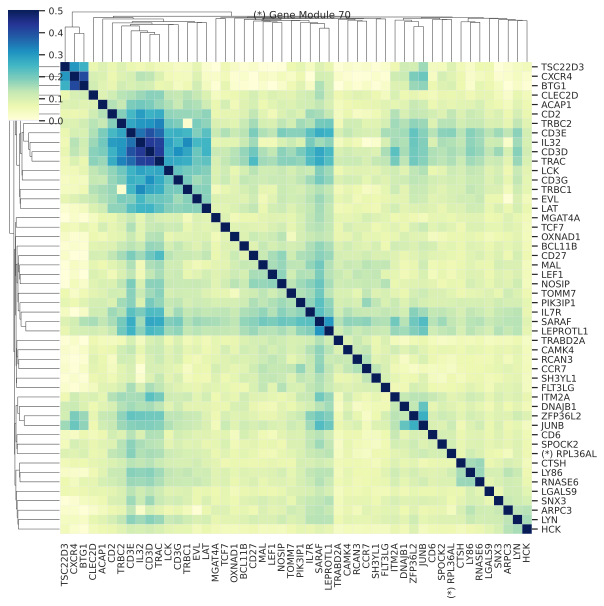

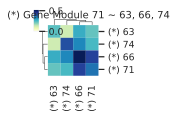

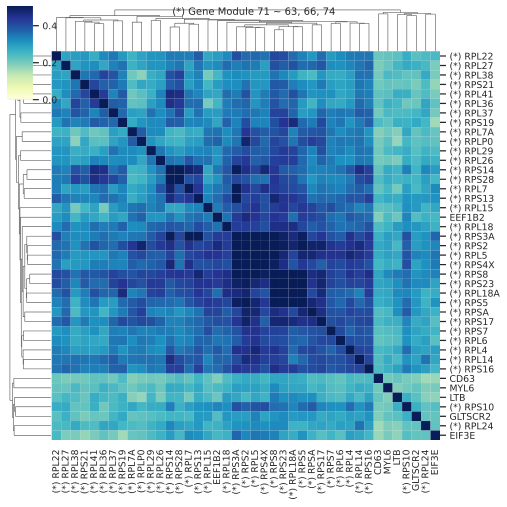

<Figure size 612x612 with 0 Axes>

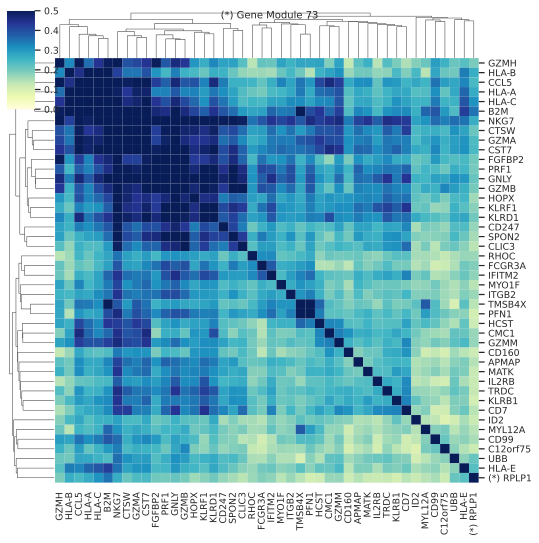

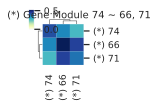

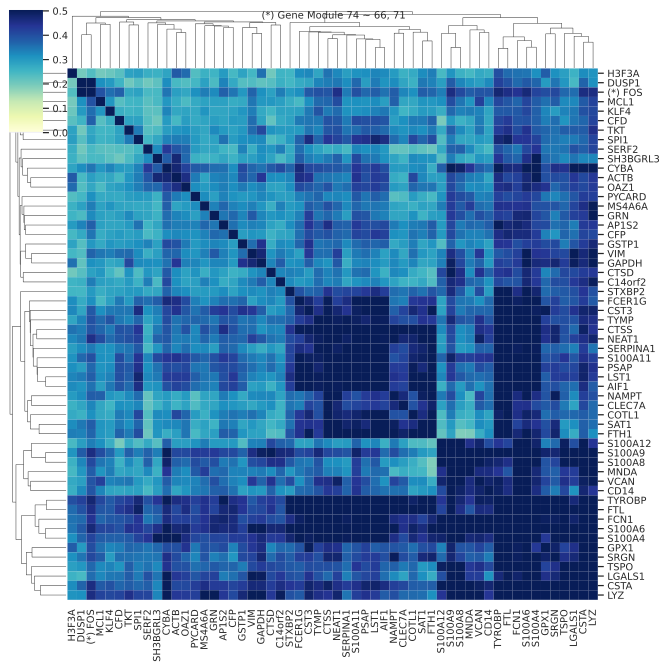

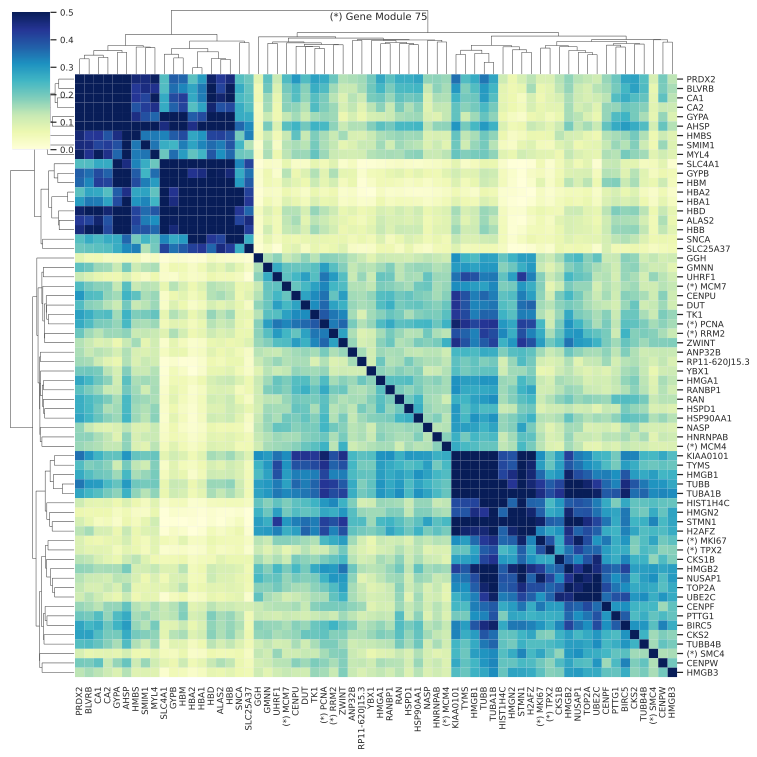

CPU times: user 1min 32s, sys: 1min 51s, total: 3min 23s
Wall time: 2min 52s


In [22]:
%%time
SHOW_CORRELATED_MODULES = 0.2 # Show non-lateral modules if correlated to lateral modules.
MIN_SIMILARITY_TO_SHOW = 0.2 # Show modules only if there's at least this correlation

base_lateral_gene_modules = np.unique(module_per_gene.values[base_lateral_genes_mask])
base_lateral_gene_modules = base_lateral_gene_modules[base_lateral_gene_modules >= 0]
similarity_of_genes = mc.ut.get_vv_frame(cells, "lateral_genes_similarity")

for gene_module in range(np.max(module_per_gene) + 1):
    module_genes_mask = module_per_gene.values == gene_module
    similarity_of_module = similarity_of_genes.loc[module_genes_mask, module_genes_mask]
    similarity_of_module.index = similarity_of_module.columns = [
        "(*) " + name if name in base_lateral_gene_names else name
        for name in similarity_of_module.index
    ]
    
    mask = similarity_of_module.values.copy()
    np.fill_diagonal(mask, 0.0)
    max_value = np.max(mask)
    show_in_notebook = gene_module in base_lateral_gene_modules or max_value >= MIN_SIMILARITY_TO_SHOW
 
    similarity_to_laterals = similarity_of_modules.iloc[gene_module, base_lateral_gene_modules]
    similar_lateral_modules_mask = similarity_to_laterals >= SHOW_CORRELATED_MODULES
    similar_lateral_modules = base_lateral_gene_modules[np.where(similar_lateral_modules_mask)[0]]
    if gene_module not in base_lateral_gene_modules and len(similar_lateral_modules) == 0:
        show_in_notebook = False
        
    prefix = "(*) " if gene_module in base_lateral_gene_modules else ""
    suffix = ", ".join([
        str(similar_lateral_module)
        for similar_lateral_module
        in similar_lateral_modules
        if similar_lateral_module != gene_module
    ])
    if suffix != "":
        suffix = " ~ " + suffix
    title = f"{prefix}Gene Module {gene_module}{suffix}"
        
    if len(similar_lateral_modules) > 0:
        with_lateral_modules = set(similar_lateral_modules)
        with_lateral_modules.add(gene_module)
        with_lateral_modules = sorted(with_lateral_modules)
        if len(with_lateral_modules) > 1:
            similarity_with_module = \
                similarity_of_modules.iloc[with_lateral_modules, :].iloc[:, with_lateral_modules]

            size = similarity_with_module.shape[0]
            if size > 50:
                sb.set(font_scale=50 / size)
            size = size * 0.15 + 1
            cm = sb.clustermap(
                similarity_with_module,
                figsize=(size, size),
                vmin=0, vmax=0.5,
                xticklabels=True, yticklabels=True,
                dendrogram_ratio=0.1,
                cmap="YlGnBu",
            )
            cm.fig.suptitle(title, fontsize=10)
            plt.savefig(f"../output/iterative/iteration-1/figures/genes_module_{gene_module}_modules.svg")
            if show_in_notebook:
                plt.show()
            else:
                plt.clf()

    size = similarity_of_module.shape[0]
    if size > 50:
        sb.set(font_scale=50 / size)
    size = size * 0.15 + 1
    cm = sb.clustermap(
        similarity_of_module,
        figsize=(size, size),
        vmin=0, vmax=0.5,
        xticklabels=True, yticklabels=True,
        dendrogram_ratio=0.1,
        cmap="YlGnBu",
    )
    cm.fig.suptitle(title, fontsize=10)
    plt.savefig(f"../output/iterative/iteration-1/figures/genes_module_{gene_module}_genes.svg")
    if show_in_notebook:
        plt.show()
    else:
        plt.clf()

Having looked at all the above (which admittedly, takes some effort), we made the following decisions (which we hope you will find to be reasonable). Again, we don't expect it to be perfect (yet), we'll revise this list in future iterations. But the better we make it now, the less iterations we'll need to make.

In [23]:
LATERAL_GENE_MODULES = [
    66, 71,  # Ribosomal.
    75,      # Cell-cycle, with some exceptions (erythrocytes).
]
SPECIFIC_LATERAL_GENES = ["DUSP1"]  # Stress
SPECIFIC_NON_LATERAL_GENES = [ # Excluded from 75, erythrocytes
    "AHSP", "ALAS2", "BLVRB", "CA1", "CA2", "GYPA", "GYPB", "HBA1", "HBA2", "HBB", "HBD", "HBM",
    "HMBS", "MYL4", "PRDX2", "SLC25A37", "SLC4A1", "SMIM1", "SNCA"
]

In [24]:
%%time
for gene_module in LATERAL_GENE_MODULES:
    module_genes_mask = module_per_gene == gene_module
    update_lateral_genes(names=cells.var_names[module_genes_mask], op="add", show=False)
update_lateral_genes(names=SPECIFIC_LATERAL_GENES, op="add", show=False)
update_lateral_genes(names=SPECIFIC_NON_LATERAL_GENES, op="remove")

set hca_bm.iteration-1.cells.var[lateral_gene]: 116 true (0.4255%) out of 27262 bools
set hca_bm.iteration-1.cells.var[lateral_gene]: 122 true (0.4475%) out of 27262 bools
set hca_bm.iteration-1.cells.var[lateral_gene]: 179 true (0.6566%) out of 27262 bools
set hca_bm.iteration-1.cells.var[lateral_gene]: 180 true (0.6603%) out of 27262 bools
set hca_bm.iteration-1.cells.var[lateral_gene]: 161 true (0.5906%) out of 27262 bools


['ANP32B', 'AURKA', 'BIRC5', 'CD63', 'CENPF', 'CENPU', 'CENPW', 'CKS1B', 'CKS2', 'DUSP1', 'DUT', 'EEF1A1', 'EEF1B2', 'EIF3E', 'FOS', 'GGH', 'GLTSCR2', 'GMNN', 'H2AFZ', 'HIST1H4C', 'HMGA1', 'HMGB1', 'HMGB2', 'HMGB3', 'HMGN2', 'HNRNPAB', 'HSP90AA1', 'HSP90AB1', 'HSPD1', 'KIAA0101', 'LTB', 'MCM3', 'MCM4', 'MCM7', 'MKI67', 'MYL6', 'NASP', 'NUSAP1', 'PCNA', 'PTTG1', 'RAN', 'RANBP1', 'RP11-620J15.3', 'RRM2', 'SMC4', 'STMN1', 'TK1', 'TOP2A', 'TPX2', 'TUBA1B', 'TUBB', 'TUBB4B', 'TXN', 'TYMS', 'UBE2C', 'UHRF1', 'YBX1', 'ZWINT']
and 103 RP[LS].* genes
CPU times: user 37.3 ms, sys: 224 µs, total: 37.6 ms
Wall time: 36.5 ms


#### 4.1.3 Noisy genes

Another important list of genes are the genes with higher than usual variance,
which will cause a lot of cells to be deviant (inconsistent with their metacells),
and therefore be marked as outliers. Marking them as "noisy" allows for more variance for these genes in each metacell, reducing the number of outliers.

We currently don't provide a cell-based method for finding such genes;
instead we wait until we have a metacells model and use that as a basis for decision instead.

#### 4.1.4 Parallelization

Finally, we need to decide on how much parallelization to use.
This is a purely technical decision - it does not affect the results, just the performance.

The more parallel piles we use, the faster the computation will be
(up to the number of physical processors, but that is handled automatically for us).

However, having more parallel piles means using more memory.
If we run out of memory, we'll need to reduce the number of parallel piles.
You can track the memory usage by running `top` or `htop` during the computation.

We provide a guesstimator for the maximal number of parallel piles that will fit in memory.
This is by no means perfect, but it is a starting point.

In [25]:
%%time
# Either use the guesstimator:
max_parallel_piles = mc.pl.guess_max_parallel_piles(cells)
# Or, if running out of memory manually override:
# max_paralle_piles = ...
print(max_parallel_piles)
mc.pl.set_max_parallel_piles(max_parallel_piles)

497
CPU times: user 8.54 s, sys: 11.1 s, total: 19.6 s
Wall time: 19.6 s


### 4.2 Computation

We are (_finally_) ready to actually group the cells into metacells. At least, for the first time. Since we don't trust the decisions we made so far too much, we don't expect these 1st iteration metacells to be worth much, either.

#### 4.2.1 Hyper-parameters

The metacells pipeline has a lot of hyper parameters you can tweak. The defaults were chosen such that scRNA-seq data, especially 10x data, should work "well" out of the box. You should read the documentation and have a good understanding of the effect of any parameter you may want to tweak, keeping in mind the synergy between some of the parameters.

If we had to call out one hyper-parameter you might wish to tweak, it would be the target_metacell_size. This specifies the "ideal" number of cells in each metacell. The algorithm works hard to keep the actual metacell size close to this value - in particular, metacells larger than twice this size will be split, and metacells which are much smaller than this size will be merged, or dissolved (become outliers).

By default this value is set to 96. Setting it to a smaller value will create more metacells, which may allow capturing more subtle differences between cell states (e.g. along a gradient); this, however, would come at the cost of making less robust estimations of each gene's expression level in each metacell. This might be a worthwhile tradeoff if your cells are of higher quality.

In this vignette, we'll use the default across all iterations. Realistically, one may try different hyper parameters in different iterations.

One technical "hyper-paramater" you must specify is the random_seed. A non-zero value will genenrate reproducible results. A zero value will generate non-reproducible results and will be slightly faster. We "strongly urge" you to use a non-zero as reproducible results are much easier to deal with.

#### 4.2.2 Assigning cells to metacells

This is the core of the method.
It can take a while.
The dataset used in this example is far from trivial - it contains ~1/3M cells.
This takes ~10 minutes to compute on a hefty (48 HT cores, 0.5TB RAM) server.
You can see progress is being made by running the computation with a progress bar.
This progress is rather non-linear,
for example there's a pause at the start when computing rare gene modules,
and it isn't smooth afterwards either.
You can skip it alltogether by getting rid of the `with` statement.

In [26]:
%%time
with mc.ut.progress_bar():
    mc.pl.divide_and_conquer_pipeline(cells, random_seed=123456)

Detect rare gene modules...
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉[06:34]

CPU times: user 3min 27s, sys: 3min 6s, total: 6min 33s
Wall time: 7min 27s


#### 4.2.3 Collecting the metacells

The above merely computed a metacell name and index for each cell ("Outliers" and negative for outlier cells). We still need to collect all the cells of each metacell, to create a new `AnnData` where each profile is a metacell. Note that in this new metacells data, we no longer have UMIs per gene; instead, for each gene, we have an estimate of the fraction of its UMIs out of the total UMIs. Since `AnnData` can only hold a single 2D dataset, the result must be a separate object (with each "observation" being a metacell), so we copy all the per-gene annotations from the cells dataset to the result.

In [27]:
%%time
metacells = mc.pl.collect_metacells(cells, name="hca_bm.iteration-1.metacells", random_seed=123456)
print(f"Iteration 1: {metacells.n_obs} metacells, {metacells.n_vars} genes")

set hca_bm.iteration-1.metacells.obs[grouped]: 3151 int64s
set hca_bm.iteration-1.metacells.obs[total_umis]: 3151 float64s
set hca_bm.iteration-1.metacells.layers[total_umis]: ndarray 3151 X 27262 float32s
set hca_bm.iteration-1.metacells.obs[__zeros_downsample_umis]: 3151 int64s
set hca_bm.iteration-1.metacells.layers[zeros]: ndarray 3151 X 27262 int32s
set hca_bm.iteration-1.cells.obs[metacell_name]: 297890 <U8s
set hca_bm.iteration-1.metacells.var[gene_ids]: 27262 objects
set hca_bm.iteration-1.metacells.var[bursty_lonely_gene]: 0 true (0%) out of 27262 bools
set hca_bm.iteration-1.metacells.var[properly_sampled_gene]: 27262 true (100%) out of 27262 bools
set hca_bm.iteration-1.metacells.var[excluded_gene]: 0 true (0%) out of 27262 bools
set hca_bm.iteration-1.metacells.var[full_gene_index]: 27262 int32s
set hca_bm.iteration-1.metacells.var[lateral_gene]: 161 true (0.5906%) out of 27262 bools
set hca_bm.iteration-1.metacells.var[lateral_genes_module]: 27262 int32s
set hca_bm.iterati

Iteration 1: 3151 metacells, 27262 genes
CPU times: user 8.76 s, sys: 46.5 s, total: 55.3 s
Wall time: 1min 6s


If the input data contains per-cell annotations of interest,
then here would be a good place to convey that data to the metacells object.
Since each metacell is a combination of multiple cells,
this requires a decision on how exactly to do this for each per-cell annotation.
We can either reduce the multiple per-cell values into a single one
(such as the most frequent value or the mean value),
or we can collect the fraction of cells that have each value in each metacell (for categorical data).
Since `AnnData` is limited to simple 2D data,
the latter is implemented as a series of per-metacell annotations (one for each possible value).
This will be handled better in `DAF`.

In [28]:
%%time

# We'll reuse this through the iterations.
def convey_cell_annotations_to_metacells() -> None:
    
    # Assign a single value for each metacell based on the cells.
    mc.tl.convey_obs_to_group(
        adata=cells, gdata=metacells,
        property_name="donor_organism.organism_age", to_property_name="sex",
        method=mc.ut.most_frequent  # This is the default, for categorical data
    )
    mc.tl.convey_obs_to_group(
        adata=cells, gdata=metacells,
        property_name="donor_organism.organism_age", to_property_name="age",
        method=np.mean
    )

    # Compute the fraction of cells with each possible value in each metacell:
    mc.tl.convey_obs_fractions_to_group(
        adata=cells, gdata=metacells,
        property_name="donor_organism.sex", to_property_name="sex"
    )

    # Age has just a few possible values so treat it as categorical.
    mc.tl.convey_obs_fractions_to_group(
        adata=cells, gdata=metacells,
        property_name="donor_organism.organism_age", to_property_name="age"
    )
    
    mc.tl.convey_obs_fractions_to_group(adata=cells, gdata=metacells, property_name="donor")
    mc.tl.convey_obs_fractions_to_group(adata=cells, gdata=metacells, property_name="batch")
    
convey_cell_annotations_to_metacells()

set hca_bm.iteration-1.metacells.obs[sex]: 3151 float32s
set hca_bm.iteration-1.metacells.obs[age]: 3151 float32s
set hca_bm.iteration-1.metacells.obs[sex_fraction_of_female]: 3151 float64s
set hca_bm.iteration-1.metacells.obs[sex_fraction_of_male]: 3151 float64s
set hca_bm.iteration-1.metacells.obs[age_fraction_of_26.0]: 3151 float64s
set hca_bm.iteration-1.metacells.obs[age_fraction_of_29.0]: 3151 float64s
set hca_bm.iteration-1.metacells.obs[age_fraction_of_32.0]: 3151 float64s
set hca_bm.iteration-1.metacells.obs[age_fraction_of_36.0]: 3151 float64s
set hca_bm.iteration-1.metacells.obs[age_fraction_of_39.0]: 3151 float64s
set hca_bm.iteration-1.metacells.obs[age_fraction_of_50.0]: 3151 float64s
set hca_bm.iteration-1.metacells.obs[age_fraction_of_52.0]: 3151 float64s
set hca_bm.iteration-1.metacells.obs[donor_fraction_of_MantonBM1]: 3151 float64s
set hca_bm.iteration-1.metacells.obs[donor_fraction_of_MantonBM2]: 3151 float64s
set hca_bm.iteration-1.metacells.obs[donor_fraction_of_M

CPU times: user 24.8 s, sys: 482 ms, total: 25.3 s
Wall time: 25.2 s


### 4.3 Computing for MCView

So we have our metacells data (that we only trust as much as our decisions leading to them).
This is pretty opaque as of itself.
`MCView` is our interactive tool for exploring the data, refining our decisions, and assigning type labels to the metacells.

However, in order to use `MCView`, we first need to compute all sort of quality control data for `MCView` to display.
This again may take a while (but much less then computing the metacells above).

In [29]:
%%time
with mc.ut.progress_bar():
    mc.pl.compute_for_mcview(adata=cells, gdata=metacells, random_seed=123456)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉[04:55]

CPU times: user 1h 18min 39s, sys: 4min 51s, total: 1h 23min 31s
Wall time: 4min 55s


Here's a preview of the 2D UMAP view of the data (without any color annotations, as we do not have type annotations yet):

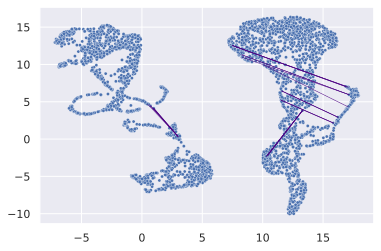

CPU times: user 1.28 s, sys: 5.04 s, total: 6.32 s
Wall time: 267 ms


In [30]:
%%time

# We'll reuse this through the iterations.
def plot_umap(*, type_annotation: Optional[str]) -> None:
    if type_annotation is not None:
        type_color_csv = pd.read_csv("../captured/type_colors.csv")
        color_of_type = pd.Series(
            list(type_color_csv["color"]) + ["magenta", "magenta"],
            index=list(type_color_csv["cell_type"]) + ["Outliers", "(Missing)"]
        )
        type_of_metacell = mc.ut.get_o_numpy(metacells, type_annotation)
        color_of_metacell = np.array(color_of_type[type_of_metacell])

    min_long_edge_size = 4
    umap_x = mc.ut.get_o_numpy(metacells, "x")
    umap_y = mc.ut.get_o_numpy(metacells, "y")
    umap_edges = sp.coo_matrix(mc.ut.get_oo_proper(metacells, "obs_outgoing_weights"))
    sb.set()
    if type_annotation is None:
        plot = sb.scatterplot(x=umap_x, y=umap_y, s=10)
    else:
        plot = sb.scatterplot(x=umap_x, y=umap_y, color=color_of_metacell, s=10)
    for (
        source_index, target_index, weight
    ) in zip(
        umap_edges.row, umap_edges.col, umap_edges.data
    ):
        source_x = umap_x[source_index]
        target_x = umap_x[target_index]
        source_y = umap_y[source_index]
        target_y = umap_y[target_index]
        if hypot(target_x - source_x, target_y - source_y) >= min_long_edge_size:
            plt.plot([source_x, target_x], [source_y, target_y],
                     linewidth=weight * 2, color='indigo')
    plt.show()
    
plot_umap(type_annotation=None)

### 4.4 Saving the data

We'll now save the results, so we can import them into `MCView`.

In [31]:
%%time
cells.write_h5ad("../output/iterative/iteration-1/hca_bm.cells.h5ad")

CPU times: user 584 ms, sys: 25 s, total: 25.5 s
Wall time: 53.7 s


In [32]:
%%time
metacells.write_h5ad("../output/iterative/iteration-1/hca_bm.metacells.h5ad")

CPU times: user 232 ms, sys: 689 ms, total: 921 ms
Wall time: 2.97 s


## 5. Importing into MCView

This vignette focuses on the metacells package, not `MCView`, which deserves a full vignette of its own. Still, here are some basics about how to use it.

### 5.1 Installing MCView

The `MCView` is written in `R` but is not a standard CRAN package.
To install it, you should type (**in `R`**):

```R
install.packages("remotes")
remotes::install_github("tanaylab/MCView")
```

### 5.2 Importing data set

Since `MCView` is written in `R`, it isn't easy to run it inside a Python notebook.
Instead we've provided a small `R` script that will load the data we saved above,
and import it into an `MCView` application. Here is the code of the script for reference:

```R
library("MCView")

args <- commandArgs(trailingOnly=TRUE)

if (length(args) == 6) {
    prefix <- args[1]
    name <- args[2]
    title <- args[3]
    type <- args[4]
    atlas_prefix <- args[5]
    atlas_name <- args[6]
    import_dataset(
        sprintf("../mcview/%s", name),                           # The directory to create
        sprintf("%s-%s", prefix, gsub("/", "-", name)),          # The name of the dataset
        sprintf("../output/%s/%s.metacells.h5ad", name, prefix), # The metacells h5ad file
        metadata_fields = "all",                                 # Ask to import all the metadata
        title = title,                                           # A title for the GUI
        cell_type_field = type,                                  # The name of the type field
        cell_type_colors_file = "../captured/type_colors.csv",   # The type colors CSV file
        projection_weights_file = sprintf("../output/%s/%s.atlas_weights.csv", name, prefix),
        atlas_project = sprintf("../mcview/%s", atlas_name),
        atlas_dataset = sprintf("%s-%s", atlas_prefix, gsub("/", "-", atlas_name)),
    )

} else if (length(args) == 4) {
    prefix <- args[1]
    name <- args[2]
    title <- args[3]
    type <- args[4]
    import_dataset(
        sprintf("../mcview/%s", name),                           # The directory to create
        sprintf("%s-%s", prefix, gsub("/", "-", name)),          # The name of the dataset
        sprintf("../output/%s/%s.metacells.h5ad", name, prefix), # The metacells h5ad file
        metadata_fields = "all",                                 # Ask to import all the metadata
        title = title,                                           # A title for the GUI
        cell_type_field = type,                                  # The name of the type field
        cell_type_colors_file = "../captured/type_colors.csv"    # The type colors CSV file
    )

} else if (length(args) == 3) {
    prefix <- args[1]
    name <- args[2]
    title <- args[3]
    import_dataset(
        sprintf("../mcview/%s", name),                           # The directory to create
        sprintf("%s-%s", prefix, gsub("/", "-", name)),          # The name of the dataset
        sprintf("../output/%s/%s.metacells.h5ad", name, prefix), # The metacells h5ad file
        metadata_fields = "all",                                 # Ask to import all the metadata
        title = title                                            # A title for the GUI
    )

} else {
    stopifnot(FALSE)
}

```

We'll just run it as an external process using `Rscript`:

In [33]:
%%time
os.system("Rscript ../scripts/import_dataset.r hca_bm iterative/iteration-1 'HCABM IT|1'")

ℹ creating ../mcview/iterative/iteration-1
→ You can edit the app configuration at '../mcview/iterative/iteration-1/config/config.yaml'
ℹ Importing hca_bm-iterative-iteration-1
ℹ Reading '../output/iterative/iteration-1/hca_bm.metacells.h5ad'
ℹ Processing metacell matrix
ℹ Processing 2d projection
ℹ Calculating top genes per metacell (marker genes)
ℹ Calculating metacell correlations of default marker genes
50%...65%...82%...95%...100%
ℹ Processing inner-folds matrix
ℹ Calculating top inner-fold genes
→ Added the Inner-fold tab to the config file. To change the tab order or remove it - edit the tabs section at: '../mcview/iterative/iteration-1/config/config.yaml'
ℹ Processing inner-stdev matrix
ℹ Calculating top inner-stdev genes
→ Added the Stdev-fold tab to the config file. To change the tab order or remove it - edit the tabs section at: '../mcview/iterative/iteration-1/config/config.yaml'
ℹ Clustering in order to get initial annotation.
ℹ using 172 genes
ℹ clustering k = 64
ℹ number

CPU times: user 20.6 ms, sys: 915 ms, total: 935 ms
Wall time: 1min 47s


0

## 6. Compute the 2nd iteration metacells

Having looked at our data in `MCView`, we are ready to revise our original decisions and compute higher quality metacells. In general, we will have to iterate several times, recomputing the metacells in each iteration, until the result is "good enough". We'll rename the data to reflect this. Note that the cells contain the old assignment to metacells; this is harmless as it will be replaced by the new metacells we'll compute.

In [34]:
%%time
mc.ut.set_name(cells, "hca_bm.iteration-2.cells")
print(f"Iteration 2: {cells.n_obs} cells, {cells.n_vars} genes")

Iteration 2: 297890 cells, 27262 genes
CPU times: user 102 µs, sys: 17 µs, total: 119 µs
Wall time: 113 µs


### 6.1 Decisions

The revised decisions below are based on the analysis we performed in `MCView`. When anlyzing the first iteration results in `MCView`, we didn't bother to even try to add type annotations to the data, which makes this simpler. In the following iterations we'll add such annotations and convey them between the iterations.

#### 6.1.2 Adding noisy genes

Looking in `MCView`, we have discovered genes which we should mark as noisy, because they have very high variance for cells with the "same" state (that is, within a metacell), and we think this makes biological sense.

The main tool we use for detecting noisy genes is the "# of metacells with significant inner-fold" QC graph. Assuming the algorithm works well, genes which have a high inner fold in many metacells must be due to them being extra noisy. These are also worth considering as lateral genes, but sometimes they are important for distinguishing between different cell types.

For example, `HBB` is noisy, but is a clear erythrocytes marker, so it should *not* be lateral:

![IGKC](../images/high-inner-fold.HBB.svg)

While `IGKC` is also noisy, but is an immunoglobulin, so it *should* be lateral:

![IGKC](../images/high-inner-fold.IGKC.svg)

In [35]:
NOISY_GENE_NAMES = [
    "CCL3", "CCL4", "CCL5", "CXCL8", "DUSP1", "FOS", "G0S2", "HBB", "HIST1H4C", "IER2", "IGKC",
    "IGLC2", "JUN", "JUNB", "KLRB1", "MT2A", "RP11", "RPS26", "RPS4Y1", "TRBC1", "TUBA1B", "TUBB"
]

In [36]:
%%time
mc.pl.mark_noisy_genes(cells, noisy_gene_names=NOISY_GENE_NAMES)

set hca_bm.iteration-2.cells.var[noisy_gene]: 21 true (0.07703%) out of 27262 bools


CPU times: user 9.07 ms, sys: 12 µs, total: 9.08 ms
Wall time: 8.68 ms


#### 6.1.3 Adding lateral genes

Similarly, even given a cursory analysis of the data (without doing any manual type annotations), we already discovered more genes we need to mark as lateral (in additions to the lateral genes we noticed while looking for noisy genes).

The main tool for identifying additional lateral genes is the marker heatmap. In general, we should have a pretty good idea about the function of each gene in this heatmap. When looking at the one we got, we noticed several genes which do not differentiate between the cell types we are interested in isolating, for example, `JUN` and `TUBA1A` (cell death).

![Markers Heatmap](../images/markers-heatmap.svg)

Another tool is looking at the inner fold heatmap. This shows genes that the metacells algorithm did not manage to homogenize well, so it is a good place to look for residual lateral behavior genes. For example, `DONSON` is related to cell cycle.

![Inner Fold Heatmap](../images/inner-fold-heatmap.svg)

Finally, it is worth looking at the genes which are highly correlated with known lateral genes (including the ones we found above). For example, `JUNB` is correlated with `JUN`.

![JUN-JUNB](../images/correlated-genes.JUN.svg)

In [37]:
ADD_LATERAL_GENE_NAMES = [
    "B2M", "BTG2", "CALM1", "COX4I1", "DNAJB1", "DONSON", "FTH1", "G0S2", "GNB2L1", "H3F3B", "HLA-A",
    "HLA-B", "HLA-C", "HLA-DMB", "HLA-DPA1", "HLA-DPB1", "HLA-DQB1", "HLA-DRA", "HLA-E", "HLA-F",
    "HSPA1A", "HSPA1B", "HSPA6", "HSPH1", "IER2", "IGHA1", "IGHA2", "IGHD", "IGHG3", "IGHM", "IGKC",
    "IGLC2", "IGLC3", "IGLC6", "IGLL1", "JUN", "JUNB", "LEPROTL1", "LGALS1", "MT2A", "MYL12A",
    "PDLIM1", "PLK3", "PPP1R15A", "PTMA", "RGCC", "SRSF7", "TMSB4X", "TUBA1A", "UBA52", "UBC",
    "YPEL5", "ZFP36"
]

In [38]:
%%time
update_lateral_genes(names=ADD_LATERAL_GENE_NAMES, op="add")

set hca_bm.iteration-2.cells.var[lateral_gene]: 214 true (0.785%) out of 27262 bools


['ANP32B', 'AURKA', 'B2M', 'BIRC5', 'BTG2', 'CALM1', 'CD63', 'CENPF', 'CENPU', 'CENPW', 'CKS1B', 'CKS2', 'COX4I1', 'DNAJB1', 'DONSON', 'DUSP1', 'DUT', 'EEF1A1', 'EEF1B2', 'EIF3E', 'FOS', 'FTH1', 'G0S2', 'GGH', 'GLTSCR2', 'GMNN', 'GNB2L1', 'H2AFZ', 'H3F3B', 'HIST1H4C', 'HLA-A', 'HLA-B', 'HLA-C', 'HLA-DMB', 'HLA-DPA1', 'HLA-DPB1', 'HLA-DQB1', 'HLA-DRA', 'HLA-E', 'HLA-F', 'HMGA1', 'HMGB1', 'HMGB2', 'HMGB3', 'HMGN2', 'HNRNPAB', 'HSP90AA1', 'HSP90AB1', 'HSPA1A', 'HSPA1B', 'HSPA6', 'HSPD1', 'HSPH1', 'IER2', 'IGHA1', 'IGHA2', 'IGHD', 'IGHG3', 'IGHM', 'IGKC', 'IGLC2', 'IGLC3', 'IGLC6', 'IGLL1', 'JUN', 'JUNB', 'KIAA0101', 'LEPROTL1', 'LGALS1', 'LTB', 'MCM3', 'MCM4', 'MCM7', 'MKI67', 'MT2A', 'MYL12A', 'MYL6', 'NASP', 'NUSAP1', 'PCNA', 'PDLIM1', 'PLK3', 'PPP1R15A', 'PTMA', 'PTTG1', 'RAN', 'RANBP1', 'RGCC', 'RP11-620J15.3', 'RRM2', 'SMC4', 'SRSF7', 'STMN1', 'TK1', 'TMSB4X', 'TOP2A', 'TPX2', 'TUBA1A', 'TUBA1B', 'TUBB', 'TUBB4B', 'TXN', 'TYMS', 'UBA52', 'UBC', 'UBE2C', 'UHRF1', 'YBX1', 'YPEL5', 'ZFP

#### 6.1.4 Parallelization

Since this will be essentially the same data set as before, normally we'll just reuse the same amount of parallelization as in the first iteration for the rest of the process.

### 6.2 Computation

The steps here just repeat what we did in the first iteration.

set hca_bm.iteration-2.cells.var[selected_gene]: * -> False


# DIVIDE AND CONQUER...


set hca_bm.iteration-2.cells.var[rare_gene]: 72 true (0.2641%) out of 27262 bools
set hca_bm.iteration-2.cells.var[rare_gene_module]: 27190 outliers (99.74%) and 72 grouped (0.2641%) out of 27262 int32 elements with 7 groups with mean size 10.29
set hca_bm.iteration-2.cells.obs[cells_rare_gene_module]: 296459 outliers (99.52%) and 1431 grouped (0.4804%) out of 297890 int32 elements with 7 groups with mean size 204.4
set hca_bm.iteration-2.cells.obs[rare_cell]: 1431 true (0.4804%) out of 297890 bools
set hca_bm.iteration-2.cells.var[selected_gene]: 3550 true (13.02%) out of 27262 bools
set hca_bm.iteration-2.cells.obs[metacell]: 297890 int32s
set hca_bm.iteration-2.cells.obs[dissolved]: 0 true (0%) out of 297890 bools
set hca_bm.iteration-2.cells.obs[metacell_level]: 297890 int32s


# COLLECT METACELLS...


set hca_bm.iteration-2.metacells.obs[grouped]: 3163 int64s
set hca_bm.iteration-2.metacells.obs[total_umis]: 3163 float64s
set hca_bm.iteration-2.metacells.layers[total_umis]: ndarray 3163 X 27262 float32s
set hca_bm.iteration-2.metacells.obs[__zeros_downsample_umis]: 3163 int64s
set hca_bm.iteration-2.metacells.layers[zeros]: ndarray 3163 X 27262 int32s
set hca_bm.iteration-2.cells.obs[metacell_name]: 297890 <U8s
set hca_bm.iteration-2.metacells.var[gene_ids]: 27262 objects
set hca_bm.iteration-2.metacells.var[bursty_lonely_gene]: 0 true (0%) out of 27262 bools
set hca_bm.iteration-2.metacells.var[properly_sampled_gene]: 27262 true (100%) out of 27262 bools
set hca_bm.iteration-2.metacells.var[excluded_gene]: 0 true (0%) out of 27262 bools
set hca_bm.iteration-2.metacells.var[full_gene_index]: 27262 int32s
set hca_bm.iteration-2.metacells.var[lateral_gene]: 214 true (0.785%) out of 27262 bools
set hca_bm.iteration-2.metacells.var[lateral_genes_module]: 27262 int32s
set hca_bm.iteratio

Iteration 2: 3163 metacells, 27262 genes
# CONVEY CELL ANNOTATIONS...


set hca_bm.iteration-2.metacells.obs[sex]: 3163 float32s
set hca_bm.iteration-2.metacells.obs[age]: 3163 float32s
set hca_bm.iteration-2.metacells.obs[sex_fraction_of_female]: 3163 float64s
set hca_bm.iteration-2.metacells.obs[sex_fraction_of_male]: 3163 float64s
set hca_bm.iteration-2.metacells.obs[age_fraction_of_26.0]: 3163 float64s
set hca_bm.iteration-2.metacells.obs[age_fraction_of_29.0]: 3163 float64s
set hca_bm.iteration-2.metacells.obs[age_fraction_of_32.0]: 3163 float64s
set hca_bm.iteration-2.metacells.obs[age_fraction_of_36.0]: 3163 float64s
set hca_bm.iteration-2.metacells.obs[age_fraction_of_39.0]: 3163 float64s
set hca_bm.iteration-2.metacells.obs[age_fraction_of_50.0]: 3163 float64s
set hca_bm.iteration-2.metacells.obs[age_fraction_of_52.0]: 3163 float64s
set hca_bm.iteration-2.metacells.obs[donor_fraction_of_MantonBM1]: 3163 float64s
set hca_bm.iteration-2.metacells.obs[donor_fraction_of_MantonBM2]: 3163 float64s
set hca_bm.iteration-2.metacells.obs[donor_fraction_of_M

# COMPUTE FOR MCVIEW...


set hca_bm.iteration-2.metacells.var[marker_gene]: 3377 true (12.39%) out of 27262 bools
set hca_bm.iteration-2.metacells.obsp[obs_balanced_ranks]: 38585 nonzero (0.3857%) out of 10004569 elements
set hca_bm.iteration-2.metacells.obsp[obs_pruned_ranks]: 12639 nonzero (0.1263%) out of 10004569 elements
set hca_bm.iteration-2.metacells.obsp[obs_outgoing_weights]: 12639 nonzero (0.1263%) out of 10004569 elements
set hca_bm.iteration-2.metacells.obsp[umap_distances]: csr_matrix 3163 X 3163 float32s (10001406 > 0, 99.97%)
set hca_bm.iteration-2.metacells.obs[u]: 3163 float32s
set hca_bm.iteration-2.metacells.obs[v]: 3163 float32s
set hca_bm.iteration-2.metacells.obs[w]: 3163 float32s
set hca_bm.iteration-2.metacells.obsp[obs_balanced_ranks]: 38585 nonzero (0.3857%) out of 10004569 elements
set hca_bm.iteration-2.metacells.obsp[obs_pruned_ranks]: 12639 nonzero (0.1263%) out of 10004569 elements
set hca_bm.iteration-2.metacells.obsp[obs_outgoing_weights]: 12639 nonzero (0.1263%) out of 100045

# PLOT UMAP...


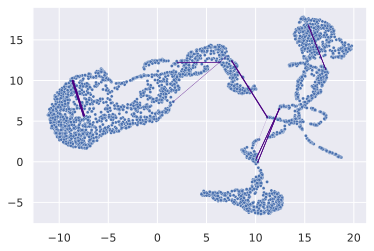

# SAVE CELLS...
# SAVE METACELLS...
# IMPORT TO MCVIEW...


ℹ creating ../mcview/iterative/iteration-2
→ You can edit the app configuration at '../mcview/iterative/iteration-2/config/config.yaml'
ℹ Importing hca_bm-iterative-iteration-2
ℹ Reading '../output/iterative/iteration-2/hca_bm.metacells.h5ad'
ℹ Processing metacell matrix
ℹ Processing 2d projection
ℹ Calculating top genes per metacell (marker genes)
ℹ Calculating metacell correlations of default marker genes
ℹ Processing inner-folds matrix
ℹ Calculating top inner-fold genes
→ Added the Inner-fold tab to the config file. To change the tab order or remove it - edit the tabs section at: '../mcview/iterative/iteration-2/config/config.yaml'
ℹ Processing inner-stdev matrix
ℹ Calculating top inner-stdev genes
→ Added the Stdev-fold tab to the config file. To change the tab order or remove it - edit the tabs section at: '../mcview/iterative/iteration-2/config/config.yaml'
ℹ Clustering in order to get initial annotation.
ℹ using 166 genes
ℹ clustering k = 64
ℹ number of features = 166
ℹ Generati

CPU times: user 1h 33min, sys: 8min 14s, total: 1h 41min 15s
Wall time: 16min 26s


In [39]:
%%time

def compute_next_iteration(next_iteration_index: int) -> None:

    print("# DIVIDE AND CONQUER...")
    global metacells
    metacells = None # So can be gc-ed
    mc.pl.divide_and_conquer_pipeline(cells, random_seed=123456)

    print("# COLLECT METACELLS...")
    metacells = mc.pl.collect_metacells(
        cells, name=f"hca_bm.iteration-{next_iteration_index}.metacells", random_seed=123456
    )
    print(f"Iteration {next_iteration_index}: {metacells.n_obs} metacells, {metacells.n_vars} genes")

    print("# CONVEY CELL ANNOTATIONS...")
    convey_cell_annotations_to_metacells()

def finalize_next_iteration(next_iteration_index: int, *, with_types: bool) -> None:
    print("# COMPUTE FOR MCVIEW...")
    mc.pl.compute_for_mcview(adata=cells, gdata=metacells, random_seed=123456)

    print("# PLOT UMAP...")
    if with_types:
        type_annotation = f"type.iteration-{next_iteration_index}.auto"
    else:
        type_annotation = None
    plot_umap(type_annotation=type_annotation)

    print("# SAVE CELLS...")
    cells.write_h5ad(f"../output/iterative/iteration-{next_iteration_index}/hca_bm.cells.h5ad")

    print("# SAVE METACELLS...")
    metacells.write_h5ad(f"../output/iterative/iteration-{next_iteration_index}/hca_bm.metacells.h5ad")

    print("# IMPORT TO MCVIEW...")
    os.system(
        f"Rscript ../scripts/import_dataset.r hca_bm iterative/iteration-{next_iteration_index} "
        f"'HCABM IT|{next_iteration_index}'"
    )

def next_iteration_without_types(next_iteration_index: int) -> None:
    compute_next_iteration(next_iteration_index)
    finalize_next_iteration(next_iteration_index, with_types=False)
    
next_iteration_without_types(2)

## 7. Annotating types in MCView

This time, we expect the metacells to have sufficient quality so it is worthwhile to provide manual type annotations for them. When we'll iterate further, we'll use the previous iteration annotations as the basis for the next one, that is, the annotations are one more decision we refine during the iterations.

### 7.1 Type annotation decisions

The basic procedure we use for annotating metacell types is to look at the markers heatmap to identify interesting genes, and then using the gene-gene plots to identify groups of metacells that present the right combination of markers to justify some type label. Here's an example gene-gene plot showing a gradient between HSC (Hematopoietic Stem Cell)
and LMPP (Lymphoid-primed Multipotent Progenitors):

![HLF-AVP](../images/gene-gene.HLF-AVP.svg)

If some metacells express a combination of markers for two unrelated types, we will consider labeling them as doublets. All these decisions require prior biological knowledge of the genes and the system. Here's an example of a doublet metacell containing a mixture of Ery (erythrocytes) and T-cells:

![HBB-TRBC1](../images/gene-gene.HBB-TRBC1.svg)

To kickstart the process, `MCView` will automatically cluster the metacells innto some groups, and give a color to each. This makes the markers heatmap at least somewhat informative even before manual type annotation has begun. Note these clusters are just as a very crude starting point. Sometimes a cluster will map well to a single cell type, but most likely, a cell type would contain metacells from several clusters, or a cluster will need to be split between two cell types.

### 7.2 Updating types in MCView

The `MCView` application is stateless, that is, any type annotations created in it are not persistent. If you close your browser's window, any annotations you made will be lost, unless you first export the types as a CSV file. You can then start a new instance of the application in your browser and import this file back to continue where you left off. We saved a copy of this exported file in `iterative.iteration-2.types.csv` which we'll use below.

You can also export a small convenience file which just contains the mapping between types and colors. In this vignette we'll assume this mapping does not change between the applications. We saved a copy of this file in `captured/type_colors.csv` - in fact, you will notice that we use this in the `scripts/import_dataset.r` script above when we create applications with type annotations already embedded in them.

These `MCView` mechanisms make it easy for a web server to deal with multiple simultaneous users which may modifying things at the same time. For the web server, the application files are read-only, which is exactly what you want when publishing data for users to see. This even allows the users to work on alternative type annotations without impacting each another.

However, this makes it more difficult for a single user which actively edits the data. The way around it is to do embed the exported file into the application's directory, that is, modify the application's disk files. From that point on, all users that will open the application will see the new type annotations.

We'll do this now, using the following simple script:

```R
library("MCView")

args <- commandArgs(trailingOnly=TRUE)
stopifnot(length(args) == 2)
name <- args[1]
types <- args[2]

update_metacell_types(
    sprintf("../mcview/%s", name),                  # The directory of the app
    sprintf("../hca_bm-%s", gsub("/", "-", name)),  # The name of the dataset
    types                                           # The types CSV files
)
```

In [40]:
%%time
os.system(
    "Rscript ../scripts/update_types.r iterative/iteration-2 "
    "../captured/iterative.iteration-2.types.csv"
)

CPU times: user 930 µs, sys: 951 ms, total: 952 ms
Wall time: 4.73 s


✔ Succesfully changed metacell cell type assignments
ℹ File has a field named 'color', updating also cell type colors.
✔ Succesfully changed cell type color assignments


0

## 8. Compute the 3rd iteration metacells

We'll again rename the data.

In [41]:
%%time
mc.ut.set_name(cells, "hca_bm.iteration-3.cells")
print(f"Iteration 3: {cells.n_obs} cells, {cells.n_vars} genes")

Iteration 3: 297890 cells, 27262 genes
CPU times: user 237 µs, sys: 31 µs, total: 268 µs
Wall time: 243 µs


### 8.1 Capturing previous type annotations

We are about to compute a new set of metacells, so these types we assigned to the old set of metacells can't be directly applied to them. Instead, we will apply the type annotations to the cells, that is, give each cell the type of its (old) metacell; then, after computing the new metacells, we'll give each one the most frequent type of the cells it contains. This is far from perfect, so we'll need to go to `MCView` again and verify and modify these types, but it is an improvement over starting the annotation from scratch.

A tricky point is that some cells are outliers (do not belong in any metacell), so we have to explicitly allow for that when applying the types to the cells.

In [42]:
%%time

# We'll reuse this through the iterations.
def capture_type_annotations_from_iteration(previous_iteration_index: int) -> np.ndarray:
    metacell_types_csv = \
        pd.read_csv(f"../captured/iterative.iteration-{previous_iteration_index}.types.csv")
    type_of_metacell = pd.Series(
        list(metacell_types_csv["cell_type"]) + ["Outliers"],
        index=list(metacell_types_csv["metacell"]) + ["Outliers"]
    )
    
    previous_metacell_of_cell = cells.obs["metacell_name"]
    type_of_cell = np.array(type_of_metacell[previous_metacell_of_cell])
    mc.ut.set_o_data(cells, f"type.iteration-{previous_iteration_index}.manual", type_of_cell)
    return type_of_cell

type_of_cell = capture_type_annotations_from_iteration(2)

set hca_bm.iteration-3.cells.obs[type.iteration-2.manual]: 297890 objects


CPU times: user 48 ms, sys: 3 ms, total: 51 ms
Wall time: 50.6 ms


### 8.2 Decisions

The revised decisions below are based on the analysis we performed in `MCView`.

#### 8.2.1 Removing doublets

Ideally, all doublets should have been removed from even the "full" data we started with. However, in the real world, we often find a few metacells which we think are doublets. Our best course of action is to remove them from the data, so they will be excluded in the next iteration.

In [43]:
%%time
doublet_cells_mask = type_of_cell == "doublets"
print(f"{np.sum(doublet_cells_mask)} cells will be excluded as doublets")

815 cells will be excluded as doublets
CPU times: user 3.35 ms, sys: 46 µs, total: 3.4 ms
Wall time: 3.16 ms


We'll just slice the data to remove the excluded doublet cells.

In [44]:
%%time
cells = mc.ut.slice(cells, obs=~doublet_cells_mask, name="hca_bm.cells.3")
print(f"Iteration 3 (~doublets): {cells.n_obs} cells, {cells.n_vars} genes")

Iteration 3 (~doublets): 297075 cells, 27262 genes
CPU times: user 26.6 s, sys: 24.1 s, total: 50.7 s
Wall time: 50.7 s


#### 8.2.2 Adding lateral genes

Even though we went through two iterations, we still discovered more lateral genes, using the same techniques as described above. Such is the nature of the beast.

In [45]:
ADD_LATERAL_GENE_NAMES = [
    "APOE", "Acsm3", "CD69", "Cdk4", "EMP3", "FOSB", "Fkbp4", "HIST1H1C", "HIST1H2AC", "HIST1H2BG",
    "HLA-DMA", "HLA-DQA1", "HLA-DRB1", "HLA_DOA", "HSPE1", "ID2", "IGHG1", "IGHG2", "IGHG4",
    "IGKV1-12", "IGKV1-39", "IGKV1-5", "IGKV3", "IGKV3-15", "IGKV4-1", "IGLC7", "IGLV2-34",
    "LINC01206", "PA2G4", "RP11-160E2.6", "RP11-53B5.1", "RP1143G9.4", "RP5-1025A1.3",
    "RP5-1171I10.5", "SRGN", "VSIR"
]

In [46]:
%%time
update_lateral_genes(names=ADD_LATERAL_GENE_NAMES, op="add")

set hca_bm.cells.3.var[lateral_gene]: 246 true (0.9024%) out of 27262 bools


['ACSM3', 'ANP32B', 'APOE', 'AURKA', 'B2M', 'BIRC5', 'BTG2', 'CALM1', 'CD63', 'CD69', 'CDK4', 'CENPF', 'CENPU', 'CENPW', 'CKS1B', 'CKS2', 'COX4I1', 'DNAJB1', 'DONSON', 'DUSP1', 'DUT', 'EEF1A1', 'EEF1B2', 'EIF3E', 'EMP3', 'FKBP4', 'FOS', 'FOSB', 'FTH1', 'G0S2', 'GGH', 'GLTSCR2', 'GMNN', 'GNB2L1', 'H2AFZ', 'H3F3B', 'HIST1H1C', 'HIST1H2AC', 'HIST1H2BG', 'HIST1H4C', 'HLA-A', 'HLA-B', 'HLA-C', 'HLA-DMA', 'HLA-DMB', 'HLA-DPA1', 'HLA-DPB1', 'HLA-DQA1', 'HLA-DQB1', 'HLA-DRA', 'HLA-DRB1', 'HLA-E', 'HLA-F', 'HMGA1', 'HMGB1', 'HMGB2', 'HMGB3', 'HMGN2', 'HNRNPAB', 'HSP90AA1', 'HSP90AB1', 'HSPA1A', 'HSPA1B', 'HSPA6', 'HSPD1', 'HSPE1', 'HSPH1', 'ID2', 'IER2', 'IGHA1', 'IGHA2', 'IGHD', 'IGHG1', 'IGHG2', 'IGHG3', 'IGHG4', 'IGHM', 'IGKC', 'IGKV1-12', 'IGKV1-39', 'IGKV1-5', 'IGKV3-15', 'IGKV4-1', 'IGLC2', 'IGLC3', 'IGLC6', 'IGLC7', 'IGLL1', 'IGLV2-34', 'JUN', 'JUNB', 'KIAA0101', 'LEPROTL1', 'LGALS1', 'LINC01206', 'LTB', 'MCM3', 'MCM4', 'MCM7', 'MKI67', 'MT2A', 'MYL12A', 'MYL6', 'NASP', 'NUSAP1', 'PA2G4'

#### 8.2.3 Adding noisy genes

This time, we haven't found any new genes to mark as noisy. These genes are much easier to detect so they typically stabilize early in the iterations.

### 8.3 Computation

The steps here just again repeat what we did in the previous iterations. However, this time we can also now automatically assign a type for each new metacell, by picking the most frequent type of the cells in it. We do not expect this to be perfect, but to serve as a more convenient starting point when reviewing the data in `MCView`.

set hca_bm.cells.3.var[selected_gene]: * -> False


# DIVIDE AND CONQUER...


set hca_bm.cells.3.var[rare_gene]: 72 true (0.2641%) out of 27262 bools
set hca_bm.cells.3.var[rare_gene_module]: 27190 outliers (99.74%) and 72 grouped (0.2641%) out of 27262 int32 elements with 7 groups with mean size 10.29
set hca_bm.cells.3.obs[cells_rare_gene_module]: 295644 outliers (99.52%) and 1431 grouped (0.4817%) out of 297075 int32 elements with 7 groups with mean size 204.4
set hca_bm.cells.3.obs[rare_cell]: 1431 true (0.4817%) out of 297075 bools
set hca_bm.cells.3.var[selected_gene]: 3592 true (13.18%) out of 27262 bools
set hca_bm.cells.3.obs[metacell]: 297075 int32s
set hca_bm.cells.3.obs[dissolved]: 0 true (0%) out of 297075 bools
set hca_bm.cells.3.obs[metacell_level]: 297075 int32s


# COLLECT METACELLS...


set hca_bm.iteration-3.metacells.obs[grouped]: 3157 int64s
set hca_bm.iteration-3.metacells.obs[total_umis]: 3157 float64s
set hca_bm.iteration-3.metacells.layers[total_umis]: ndarray 3157 X 27262 float32s
set hca_bm.iteration-3.metacells.obs[__zeros_downsample_umis]: 3157 int64s
set hca_bm.iteration-3.metacells.layers[zeros]: ndarray 3157 X 27262 int32s
set hca_bm.cells.3.obs[metacell_name]: 297075 <U8s
set hca_bm.iteration-3.metacells.var[gene_ids]: 27262 objects
set hca_bm.iteration-3.metacells.var[bursty_lonely_gene]: 0 true (0%) out of 27262 bools
set hca_bm.iteration-3.metacells.var[properly_sampled_gene]: 27262 true (100%) out of 27262 bools
set hca_bm.iteration-3.metacells.var[excluded_gene]: 0 true (0%) out of 27262 bools
set hca_bm.iteration-3.metacells.var[full_gene_index]: 27262 int32s
set hca_bm.iteration-3.metacells.var[lateral_gene]: 246 true (0.9024%) out of 27262 bools
set hca_bm.iteration-3.metacells.var[lateral_genes_module]: 27262 int32s
set hca_bm.iteration-3.metac

Iteration 3: 3157 metacells, 27262 genes
# CONVEY CELL ANNOTATIONS...


set hca_bm.iteration-3.metacells.obs[sex]: 3157 float32s
set hca_bm.iteration-3.metacells.obs[age]: 3157 float32s
set hca_bm.iteration-3.metacells.obs[sex_fraction_of_female]: 3157 float64s
set hca_bm.iteration-3.metacells.obs[sex_fraction_of_male]: 3157 float64s
set hca_bm.iteration-3.metacells.obs[age_fraction_of_26.0]: 3157 float64s
set hca_bm.iteration-3.metacells.obs[age_fraction_of_29.0]: 3157 float64s
set hca_bm.iteration-3.metacells.obs[age_fraction_of_32.0]: 3157 float64s
set hca_bm.iteration-3.metacells.obs[age_fraction_of_36.0]: 3157 float64s
set hca_bm.iteration-3.metacells.obs[age_fraction_of_39.0]: 3157 float64s
set hca_bm.iteration-3.metacells.obs[age_fraction_of_50.0]: 3157 float64s
set hca_bm.iteration-3.metacells.obs[age_fraction_of_52.0]: 3157 float64s
set hca_bm.iteration-3.metacells.obs[donor_fraction_of_MantonBM1]: 3157 float64s
set hca_bm.iteration-3.metacells.obs[donor_fraction_of_MantonBM2]: 3157 float64s
set hca_bm.iteration-3.metacells.obs[donor_fraction_of_M

# APPLY PREVIOUS ITERATION TYPES


set hca_bm.iteration-3.metacells.obs[type.iteration-3.auto]: 3157 <U9s
set hca_bm.iteration-3.metacells.uns[mcview_format]: 1.0
set hca_bm.iteration-3.metacells.uns[outliers]: 154


# COMPUTE FOR MCVIEW...


set hca_bm.iteration-3.metacells.var[marker_gene]: 3463 true (12.7%) out of 27262 bools
set hca_bm.iteration-3.metacells.obsp[obs_balanced_ranks]: 38527 nonzero (0.3866%) out of 9966649 elements
set hca_bm.iteration-3.metacells.obsp[obs_pruned_ranks]: 12601 nonzero (0.1264%) out of 9966649 elements
set hca_bm.iteration-3.metacells.obsp[obs_outgoing_weights]: 12601 nonzero (0.1264%) out of 9966649 elements
set hca_bm.iteration-3.metacells.obsp[umap_distances]: csr_matrix 3157 X 3157 float32s (9963492 > 0, 99.97%)
set hca_bm.iteration-3.metacells.obs[u]: 3157 float32s
set hca_bm.iteration-3.metacells.obs[v]: 3157 float32s
set hca_bm.iteration-3.metacells.obs[w]: 3157 float32s
set hca_bm.iteration-3.metacells.obsp[obs_balanced_ranks]: 38527 nonzero (0.3866%) out of 9966649 elements
set hca_bm.iteration-3.metacells.obsp[obs_pruned_ranks]: 12601 nonzero (0.1264%) out of 9966649 elements
set hca_bm.iteration-3.metacells.obsp[obs_outgoing_weights]: 12601 nonzero (0.1264%) out of 9966649 eleme

# PLOT UMAP...


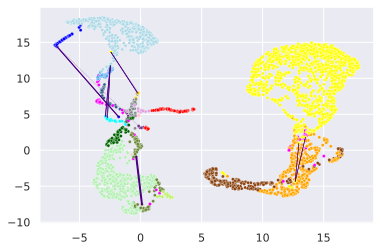

# SAVE CELLS...
# SAVE METACELLS...
# IMPORT TO MCVIEW...


ℹ creating ../mcview/iterative/iteration-3
→ You can edit the app configuration at '../mcview/iterative/iteration-3/config/config.yaml'
ℹ Importing hca_bm-iterative-iteration-3
ℹ Reading '../output/iterative/iteration-3/hca_bm.metacells.h5ad'
ℹ Processing metacell matrix
ℹ Processing 2d projection
ℹ Calculating top genes per metacell (marker genes)
ℹ Calculating metacell correlations of default marker genes
ℹ Processing inner-folds matrix
ℹ Calculating top inner-fold genes
→ Added the Inner-fold tab to the config file. To change the tab order or remove it - edit the tabs section at: '../mcview/iterative/iteration-3/config/config.yaml'
ℹ Processing inner-stdev matrix
ℹ Calculating top inner-stdev genes
→ Added the Stdev-fold tab to the config file. To change the tab order or remove it - edit the tabs section at: '../mcview/iterative/iteration-3/config/config.yaml'
ℹ Clustering in order to get initial annotation.
ℹ using 164 genes
ℹ clustering k = 64
ℹ number of features = 164
ℹ Generati

CPU times: user 1h 45min, sys: 9min 15s, total: 1h 54min 15s
Wall time: 17min 4s


In [47]:
%%time

def next_iteration_with_types(next_iteration_index: int) -> None:
    compute_next_iteration(next_iteration_index)

    print("# APPLY PREVIOUS ITERATION TYPES")  # TRICKY: Uses *NEW* metacells!
    mc.tl.convey_obs_to_group(
        adata=cells, gdata=metacells,
        property_name=f"type.iteration-{next_iteration_index - 1}.manual",
        to_property_name=f"type.iteration-{next_iteration_index}.auto",
    )

    finalize_next_iteration(next_iteration_index, with_types=True)

next_iteration_with_types(3)

## 9. Computing 4th iteration metacells

We'll do another iteration, similar to the previous one. Depending on the intended usage, it may take many iterations until the results are "good enough".

In [48]:
%%time
mc.ut.set_name(cells, "hca_bm.iteration-4.cells")
print(f"Iteration 4: {cells.n_obs} cells, {cells.n_vars} genes")
type_of_cell = capture_type_annotations_from_iteration(3)

set hca_bm.iteration-4.cells.obs[type.iteration-3.manual]: 297075 objects


Iteration 4: 297075 cells, 27262 genes
CPU times: user 49.1 ms, sys: 9.02 ms, total: 58.1 ms
Wall time: 76.2 ms


### 9.1 Decisions

The revised decisions below are based on the analysis we performed in `MCView`, similar to what we did in the previous iterations.

#### 9.1.1 Removing excluded genes

This time we noticed `NEAT1` is causing problems, and upon consideration, decided it is not sufficient to mark it as lateral. Instead we want to exclude it from the data, so it will not impact the denominator (total UMIs in each cell), as it is a very high expressing gene.

In general we care about the fraction of the UMIs of each gene out of the total for each cell. A very highly expressed gene may therefore cause other genes to appear to be unner-expressed. This is part of the reason why, for example, we excluded the `MT-.*` mytochondrial genes from the analysis. One should be careful though because this is a very blunt tool to apply to the data.

In [49]:
EXCLUDED_GENE_NAMES = [ "NEAT1" ]

We'll just compute a mask of the additional (well, single) excluded gene and apply it below.

In [50]:
%%time
excluded_genes_mask = np.array(mc.tl.find_named_genes(cells, names=EXCLUDED_GENE_NAMES))
print(f"{np.sum(excluded_genes_mask)} genes will be excluded")

1 genes will be excluded
CPU times: user 6.33 ms, sys: 927 µs, total: 7.26 ms
Wall time: 7.03 ms


#### 9.1.2 Removing doublets

We discovered a few more doublets. Blood data is notorious for containing doublets because blood cells are "sticky".

In [51]:
%%time
doublet_cells_mask = type_of_cell == "doublets"
print(f"{np.sum(doublet_cells_mask)} cells will be excluded as doublets")

382 cells will be excluded as doublets
CPU times: user 3.45 ms, sys: 0 ns, total: 3.45 ms
Wall time: 3.19 ms


We'll again simply slice the set of cells and genes we use next:

In [52]:
%%time
cells = mc.ut.slice(cells, obs=~doublet_cells_mask, vars=~excluded_genes_mask, name="hca_bm.cells.4")
print(f"Iteration 4 (~doubles, ~genes): {cells.n_obs} cells, {cells.n_vars} genes")

Iteration 4 (~doubles, ~genes): 296693 cells, 27261 genes
CPU times: user 28.7 s, sys: 34.1 s, total: 1min 2s
Wall time: 1min 2s


#### 9.1.3 Adding lateral genes

Even though we went through three iterations so far, we still discovered more lateral genes. This only *appears* to be an endless process, though; it *does* converge. Eventually.

In [53]:
ADD_LATERAL_GENE_NAMES = [
    "CH17-373J23.1", "CXCR4", "GPR183", "HBM", "IGLL5", "NFKBIA", "TSC22D3", "RP11-1143G9.4",
    "RGS1", "RGS2", "RGS3",
]

In [54]:
%%time
update_lateral_genes(names=ADD_LATERAL_GENE_NAMES, op="add")

set hca_bm.cells.4.var[lateral_gene]: 257 true (0.9427%) out of 27261 bools


['ACSM3', 'ANP32B', 'APOE', 'AURKA', 'B2M', 'BIRC5', 'BTG2', 'CALM1', 'CD63', 'CD69', 'CDK4', 'CENPF', 'CENPU', 'CENPW', 'CH17-373J23.1', 'CKS1B', 'CKS2', 'COX4I1', 'CXCR4', 'DNAJB1', 'DONSON', 'DUSP1', 'DUT', 'EEF1A1', 'EEF1B2', 'EIF3E', 'EMP3', 'FKBP4', 'FOS', 'FOSB', 'FTH1', 'G0S2', 'GGH', 'GLTSCR2', 'GMNN', 'GNB2L1', 'GPR183', 'H2AFZ', 'H3F3B', 'HBM', 'HIST1H1C', 'HIST1H2AC', 'HIST1H2BG', 'HIST1H4C', 'HLA-A', 'HLA-B', 'HLA-C', 'HLA-DMA', 'HLA-DMB', 'HLA-DPA1', 'HLA-DPB1', 'HLA-DQA1', 'HLA-DQB1', 'HLA-DRA', 'HLA-DRB1', 'HLA-E', 'HLA-F', 'HMGA1', 'HMGB1', 'HMGB2', 'HMGB3', 'HMGN2', 'HNRNPAB', 'HSP90AA1', 'HSP90AB1', 'HSPA1A', 'HSPA1B', 'HSPA6', 'HSPD1', 'HSPE1', 'HSPH1', 'ID2', 'IER2', 'IGHA1', 'IGHA2', 'IGHD', 'IGHG1', 'IGHG2', 'IGHG3', 'IGHG4', 'IGHM', 'IGKC', 'IGKV1-12', 'IGKV1-39', 'IGKV1-5', 'IGKV3-15', 'IGKV4-1', 'IGLC2', 'IGLC3', 'IGLC6', 'IGLC7', 'IGLL1', 'IGLL5', 'IGLV2-34', 'JUN', 'JUNB', 'KIAA0101', 'LEPROTL1', 'LGALS1', 'LINC01206', 'LTB', 'MCM3', 'MCM4', 'MCM7', 'MKI67',

### 9.2 Computation

The steps here just again repeat what we did in the previous iterations.

set hca_bm.cells.4.var[selected_gene]: * -> False


# DIVIDE AND CONQUER...


set hca_bm.cells.4.var[rare_gene]: 73 true (0.2678%) out of 27261 bools
set hca_bm.cells.4.var[rare_gene_module]: 27188 outliers (99.73%) and 73 grouped (0.2678%) out of 27261 int32 elements with 7 groups with mean size 10.43
set hca_bm.cells.4.obs[cells_rare_gene_module]: 295318 outliers (99.54%) and 1375 grouped (0.4634%) out of 296693 int32 elements with 7 groups with mean size 196.4
set hca_bm.cells.4.obs[rare_cell]: 1375 true (0.4634%) out of 296693 bools
set hca_bm.cells.4.var[selected_gene]: 3547 true (13.01%) out of 27261 bools
set hca_bm.cells.4.obs[metacell]: 296693 int32s
set hca_bm.cells.4.obs[dissolved]: 0 true (0%) out of 296693 bools
set hca_bm.cells.4.obs[metacell_level]: 296693 int32s


# COLLECT METACELLS...


set hca_bm.iteration-4.metacells.obs[grouped]: 3149 int64s
set hca_bm.iteration-4.metacells.obs[total_umis]: 3149 float64s
set hca_bm.iteration-4.metacells.layers[total_umis]: ndarray 3149 X 27261 float32s
set hca_bm.iteration-4.metacells.obs[__zeros_downsample_umis]: 3149 int64s
set hca_bm.iteration-4.metacells.layers[zeros]: ndarray 3149 X 27261 int32s
set hca_bm.cells.4.obs[metacell_name]: 296693 <U8s
set hca_bm.iteration-4.metacells.var[gene_ids]: 27261 objects
set hca_bm.iteration-4.metacells.var[bursty_lonely_gene]: 0 true (0%) out of 27261 bools
set hca_bm.iteration-4.metacells.var[properly_sampled_gene]: 27261 true (100%) out of 27261 bools
set hca_bm.iteration-4.metacells.var[excluded_gene]: 0 true (0%) out of 27261 bools
set hca_bm.iteration-4.metacells.var[full_gene_index]: 27261 int32s
set hca_bm.iteration-4.metacells.var[lateral_gene]: 257 true (0.9427%) out of 27261 bools
set hca_bm.iteration-4.metacells.var[lateral_genes_module]: 27261 int32s
set hca_bm.iteration-4.metac

Iteration 4: 3149 metacells, 27261 genes
# CONVEY CELL ANNOTATIONS...


set hca_bm.iteration-4.metacells.obs[sex]: 3149 float32s
set hca_bm.iteration-4.metacells.obs[age]: 3149 float32s
set hca_bm.iteration-4.metacells.obs[sex_fraction_of_female]: 3149 float64s
set hca_bm.iteration-4.metacells.obs[sex_fraction_of_male]: 3149 float64s
set hca_bm.iteration-4.metacells.obs[age_fraction_of_26.0]: 3149 float64s
set hca_bm.iteration-4.metacells.obs[age_fraction_of_29.0]: 3149 float64s
set hca_bm.iteration-4.metacells.obs[age_fraction_of_32.0]: 3149 float64s
set hca_bm.iteration-4.metacells.obs[age_fraction_of_36.0]: 3149 float64s
set hca_bm.iteration-4.metacells.obs[age_fraction_of_39.0]: 3149 float64s
set hca_bm.iteration-4.metacells.obs[age_fraction_of_50.0]: 3149 float64s
set hca_bm.iteration-4.metacells.obs[age_fraction_of_52.0]: 3149 float64s
set hca_bm.iteration-4.metacells.obs[donor_fraction_of_MantonBM1]: 3149 float64s
set hca_bm.iteration-4.metacells.obs[donor_fraction_of_MantonBM2]: 3149 float64s
set hca_bm.iteration-4.metacells.obs[donor_fraction_of_M

# APPLY PREVIOUS ITERATION TYPES


set hca_bm.iteration-4.metacells.obs[type.iteration-4.auto]: 3149 <U9s
set hca_bm.iteration-4.metacells.uns[mcview_format]: 1.0
set hca_bm.iteration-4.metacells.uns[outliers]: 140


# COMPUTE FOR MCVIEW...


set hca_bm.iteration-4.metacells.var[marker_gene]: 3334 true (12.23%) out of 27261 bools
set hca_bm.iteration-4.metacells.obsp[obs_balanced_ranks]: 38473 nonzero (0.388%) out of 9916201 elements
set hca_bm.iteration-4.metacells.obsp[obs_pruned_ranks]: 12579 nonzero (0.1269%) out of 9916201 elements
set hca_bm.iteration-4.metacells.obsp[obs_outgoing_weights]: 12579 nonzero (0.1269%) out of 9916201 elements
set hca_bm.iteration-4.metacells.obsp[umap_distances]: csr_matrix 3149 X 3149 float32s (9913050 > 0, 99.97%)
set hca_bm.iteration-4.metacells.obs[u]: 3149 float32s
set hca_bm.iteration-4.metacells.obs[v]: 3149 float32s
set hca_bm.iteration-4.metacells.obs[w]: 3149 float32s
set hca_bm.iteration-4.metacells.obsp[obs_balanced_ranks]: 38473 nonzero (0.388%) out of 9916201 elements
set hca_bm.iteration-4.metacells.obsp[obs_pruned_ranks]: 12579 nonzero (0.1269%) out of 9916201 elements
set hca_bm.iteration-4.metacells.obsp[obs_outgoing_weights]: 12579 nonzero (0.1269%) out of 9916201 elemen

# PLOT UMAP...


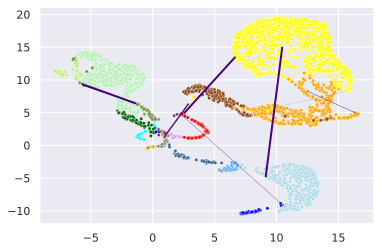

# SAVE CELLS...
# SAVE METACELLS...
# IMPORT TO MCVIEW...


ℹ creating ../mcview/iterative/iteration-4
→ You can edit the app configuration at '../mcview/iterative/iteration-4/config/config.yaml'
ℹ Importing hca_bm-iterative-iteration-4
ℹ Reading '../output/iterative/iteration-4/hca_bm.metacells.h5ad'
ℹ Processing metacell matrix
ℹ Processing 2d projection
ℹ Calculating top genes per metacell (marker genes)
ℹ Calculating metacell correlations of default marker genes
ℹ Processing inner-folds matrix
ℹ Calculating top inner-fold genes
→ Added the Inner-fold tab to the config file. To change the tab order or remove it - edit the tabs section at: '../mcview/iterative/iteration-4/config/config.yaml'
ℹ Processing inner-stdev matrix
ℹ Calculating top inner-stdev genes
→ Added the Stdev-fold tab to the config file. To change the tab order or remove it - edit the tabs section at: '../mcview/iterative/iteration-4/config/config.yaml'
ℹ Clustering in order to get initial annotation.
ℹ using 163 genes
ℹ clustering k = 64
ℹ number of features = 163
ℹ Generati

CPU times: user 1h 42min 12s, sys: 8min 40s, total: 1h 50min 52s
Wall time: 16min 14s


In [55]:
%%time
next_iteration_with_types(4)

## 10. Finalizing the data

At some point, one must declare the results to be "good enough" and wrap things up. This point "depends".

If one is working on a very large data set, with the intent to publishing it as an atlas for other researches to use as reference, one would (presumably) invest much more effort ensuring the quality of metacells and type annotations for each of the cell types.

In contrast, if one is working on a small data set, and is investigating a specific biological question (e.g. comparing a specific cell type between wild type and knockout organisms), one can focus the effort on specific cell types, and use coarse grained annotations for the rest (and worry much less about their quality in general).

Either way, the decision of when "enough is enough" will depend on the analyst's judgement, just like every other decision we have discussed so far.

In this specific example, the purpose of the vignette is merely to demonstrate the iterative process. We therefore decided to stop here. To remove doubt, the results presented here are **not** suitable for use in any serious analysis. This is an example of the process, nothing more.

All that said, wrapping things up requires taking a few extra steps we'll discuss below. We'll start by renaming the data to indicate it is the final result.

In [56]:
%%time
mc.ut.set_name(cells, "hca_bm.iterative-final.cells")
print(f"Final: {cells.n_obs} cells, {cells.n_vars} genes")
mc.ut.set_name(metacells, "hca_bm.iterative-final.cells")
print(f"Final: {metacells.n_obs} metacells, {metacells.n_vars} genes")

Final: 296693 cells, 27261 genes
Final: 3149 metacells, 27261 genes
CPU times: user 219 µs, sys: 24 µs, total: 243 µs
Wall time: 226 µs


### 10.1 Conveying type annotations

Because we will not be recomputing the metacells this time, we can apply the final type annotations from our work in MCView to both the cells (as in previous iterations) and the metacells.

In [57]:
%%time
metacell_types_csv = pd.read_csv("../captured/iterative.iteration-4.types.csv")
assert np.all(metacell_types_csv["metacell"] == metacells.obs_names)

type_of_metacell = np.array(metacell_types_csv["cell_type"])
mc.ut.set_o_data(metacells, "type", type_of_metacell)

type_of_metacell = pd.Series(
    list(type_of_metacell) + ["Outliers"],
    index=list(metacell_types_csv["metacell"]) + ["Outliers"]
)

metacell_of_cell = cells.obs["metacell_name"]
type_of_cell = np.array(type_of_metacell[metacell_of_cell])
mc.ut.set_o_data(cells, "type", type_of_cell)

set hca_bm.iterative-final.cells.obs[type]: 3149 objects
set hca_bm.iterative-final.cells.obs[type]: 296693 objects


CPU times: user 62.4 ms, sys: 8.85 ms, total: 71.3 ms
Wall time: 82.4 ms


### 10.2 Marking essential genes

If we are preparing a reference atlas, that is, we expect to project other data into it (a process which is the subject of a separate vignette TODO), then it is recommended to designate a few genes as "essential" for each cell type.

When we will project data onto the atlas, we'll do a lot of quality assurance to ensure the projection makes biological sense. The (optional) essential genes help with this quality assurance. Specifically, if a gene is designated as essential for some cell type, and some projected data "seems like" it is of this cell type, we'll ensure that this data agrees with the atlas for the essential genes. For example, if the projected metacell does not express CD8, then we can't say it is a CD8 T-cell. It may be very *similar* to a CD8 T-cell, but we just can't reasonably that it *is* one.

Selecting the (few) genes to use as essenntial for each cell type requires, as usual, the expertise of the biologist preparing the atlas. Note that all we require is a list of genes, *not* some quantitative threshold to use as a cell type classifier. The quantitative aspect is automatically provided by the projection algorithm itself (which is outside the scope of this vignette).

In [58]:
#mc.ut.mark_essential_genes(
#    metacells,
#    essential_gene_names_of_types={ "CD8 T-cell" => ["CD8", ...], ...}
#)

### 10.3 Removing doublet meta/cells

Some of the metacells were annotated as doublets. In a realistic iterative process, we would exclude the cells of these metacells, re-compute the metacells, and re-annotate them. Since we artificially stopped at this point in the process, we'll skip these steps, leaving the doublets in these so-called "final" results.

### 10.4 Spit and polish in general

This is a good place to delete, rename, compute and in general ensure all per-gene and per-metacell properties exist, are properly named, etc. Again, how much effort (if any) is put into this varies greatly depending on the specific scennario.

Just as an example, here we'll delete the type annotations from the previous iterations from the data, because they will only confuse anyone using the final result.

In [59]:
%%time

for iteration_index in range(100):  # Complete overkill
    for name in (
        f"type.iteration-{iteration_index}.auto",
        f"type.iteration-{iteration_index}.manual"
    ):
        for adata in (cells, metacells):
            if name in adata.obs:
                print(f"Delete {name} from {mc.ut.get_name(cells)}")
                del adata.obs[name]

Delete type.iteration-2.manual from hca_bm.iterative-final.cells
Delete type.iteration-3.manual from hca_bm.iterative-final.cells
Delete type.iteration-4.auto from hca_bm.iterative-final.cells
CPU times: user 350 µs, sys: 2.04 ms, total: 2.39 ms
Wall time: 2.15 ms


### 10.5 Computing for MCView

We've already computed all the `MCView` data. Yes, we have changed the assignment of types to metacells since, but none of the computed data actually depends on these types, so there's no need to compute it again.

### 10.6 Saving the final results

We'll save the results in some location that makes it clear that this is the final data. In a real process, this would be what we'd publish out of it as a "metacells atlas". In fact, typically such an atlas wouldn't even contain the cells data, but we store it for completeness, and in case "somethings comes up" and we have to do a few more iterations.

In [60]:
%%time

print("# SAVE CELLS...")
cells.write_h5ad("../output/iterative/final/hca_bm.cells.h5ad")

print("# SAVE METACELLS...")
metacells.write_h5ad("../output/iterative/final/hca_bm.metacells.h5ad")

print("# IMPORT INTO MCVIEW...")
os.system("Rscript ../scripts/import_dataset.r hca_bm iterative/final 'HCABM IT|FIN' type")

# SAVE CELLS...
# SAVE METACELLS...
# IMPORT INTO MCVIEW...


ℹ creating ../mcview/iterative/final
→ You can edit the app configuration at '../mcview/iterative/final/config/config.yaml'
ℹ Importing hca_bm-iterative-final
ℹ Reading '../output/iterative/final/hca_bm.metacells.h5ad'
ℹ Processing metacell matrix
ℹ Processing 2d projection
ℹ Calculating top genes per metacell (marker genes)
ℹ Calculating metacell correlations of default marker genes
ℹ Processing inner-folds matrix
ℹ Calculating top inner-fold genes
→ Added the Inner-fold tab to the config file. To change the tab order or remove it - edit the tabs section at: '../mcview/iterative/final/config/config.yaml'
ℹ Processing inner-stdev matrix
ℹ Calculating top inner-stdev genes
→ Added the Stdev-fold tab to the config file. To change the tab order or remove it - edit the tabs section at: '../mcview/iterative/final/config/config.yaml'
ℹ Taking cell type annotations from type field in the anndata object
ℹ Loading cell type color annotations from '../captured/type_colors.csv'
ℹ Clustering in or

CPU times: user 1.35 s, sys: 18.8 s, total: 20.1 s
Wall time: 2min 21s


0

That's it. We now have our final results, both as `h5ad` files and as an `MCView` application, to use as we see fit.

To remove doubt, the results presented here are **not** suitable for use in any serious analysis. This is an example of the process, nothing more.